# Artificial Intelligence
# 464/664
# Assignment #5

## General Directions for this Assignment

00. We're using a Jupyter Notebook environment (tutorial available here: https://jupyter-notebook-beginner-guide.readthedocs.io/en/latest/what_is_jupyter.html),
01. Read the entire notebook before beginning your work, 
02. Output format should be exactly as requested (it is your responsibility to make sure notebook looks as expected on Gradescope),
03. Each helper function should be preceeded by documentation (Markdown cell),
04. No comments in the code; anything worth mentioning should be included in the documentation,
05. Use descriptive variable names,
06. Functions should do only one thing,
07. Check submission deadline on Gradescope, 
08. Rename the file to Last_First_assignment_5, 
09. Submit your notebook (as .ipynb, not PDF) using Gradescope, and
10. Do not submit any other files.

## Directions _not_ applicable for this Assignment:
* Do not use classes,
* Keep functions to 20 lines or less (including empty lines so do not add any),
* Each helper function should be followed by three assert-style unit tests.

## Before You Submit...

1. Re-read the general instructions provided above, and
2. Hit "Kernel"->"Restart & Run All".

## Import Statements + Constants

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import networkx as nx
from copy import deepcopy
import numpy as np
from queue import PriorityQueue

## Europe Graph

In [2]:
europe_graph = {
    "nodes":  ["Iceland", "Ireland", "United Kingdom", "Portugal", "Spain",
                 "France", "Belgium", "Netherlands", "Luxembourg", "Germany",
                 "Denmark", "Norway", "Sweden", "Finland", "Estonia",
                 "Latvia", "Lithuania", "Poland", "Czech Republic", "Austria",
                 "Liechtenstein", "Switzerland", "Italy", "Malta", "Greece",
                 "Albania", "Macedonia", "Kosovo", "Montenegro", "Bosnia Herzegovina",
                 "Serbia", "Croatia", "Slovenia", "Hungary", "Slovakia",
                 "Belarus", "Ukraine", "Moldova", "Romania", "Bulgaria",
                 "Cyprus", "Turkey", "Georgia", "Armenia", "Azerbaijan",
                 "Russia" ], 
    "edges": [(0,1), (0,2), (1,2), (2,5), (2,6), (2,7), (2,11), (3,4),
                 (4,5), (4,22), (5,6), (5,8), (5,9), (5,21), (5,22),(6,7),
                 (6,8), (6,9), (7,9), (8,9), (9,10), (9,12), (9,17), (9,18),
                 (9,19), (9,21), (10,11), (10,12), (10,17), (11,12), (11,13), (11,45), 
                 (12,13), (12,14), (12,15), (12,17), (13,14), (13,45), (14,15),
                 (14,45), (15,16), (15,35), (15,45), (16,17), (16,35), (17,18),
                 (17,34), (17,35), (17,36), (18,19), (18,34), (19,20), (19,21), 
                 (19,22), (19,32), (19,33), (19,34), (20,21), (21,22), (22,23),
                 (22,24), (22,25), (22,28), (22,29), (22,31), (22,32), (24,25),
                 (24,26), (24,39), (24,40), (24,41), (25,26), (25,27), (25,28),
                 (26,27), (26,30), (26,39), (27,28), (27,30), (28,29), (28,30),
                 (29,30), (29,31), (30,31), (30,33), (30,38), (30,39), (31,32),
                 (31,33), (32,33), (33,34), (33,36), (33,38), (34,36), (35,36),
                 (35,45), (36,37), (36,38), (36,45), (37,38), (38,39), (39,41),
                 (40,41), (41,42), (41,43), (41,44), (42,43), (42,44), (42,45),
                 (43,44), (44,45)],
    "coordinates": [( 18,147), ( 48, 83), ( 64, 90), ( 47, 28), ( 63, 34),
                   ( 78, 55), ( 82, 74), ( 84, 80), ( 82, 69), (100, 78),
                   ( 94, 97), (110,162), (116,144), (143,149), (140,111),
                   (137,102), (136, 95), (122, 78), (110, 67), (112, 60),
                   ( 98, 59), ( 93, 55), (102, 35), (108, 14), (130, 22),
                   (125, 32), (128, 37), (127, 40), (122, 42), (118, 47),
                   (127, 48), (116, 53), (111, 54), (122, 57), (124, 65),
                   (146, 87), (158, 65), (148, 57), (138, 54), (137, 41),
                   (160, 13), (168, 29), (189, 39), (194, 32), (202, 33),
                   (191,118)]}

# GA_Config Class

The `GA_Config` class is designed to provide configuration options for a genetic algorithm, specifying parameters that control the size of the population, the selection strategy, mutation and crossover settings, and more. This configuration enables flexibility in tuning the algorithm for various optimization tasks.

## Class Overview

Genetic algorithms simulate the process of natural evolution to solve optimization problems. This configuration class encapsulates key parameters, allowing users to control aspects such as the population size, selection strategy, mutation, and crossover behaviors.

## Parameters

Below are the parameters provided by the `GA_Config` class:

- ### `init_pop_size` (int)
    - **Description**: The initial size of the population for each generation.
    - **Purpose**: A larger initial population can increase diversity, potentially improving the quality of solutions but may increase computation time.

- ### `parent_select_strat` (str)
    - **Description**: The strategy used for selecting parents in each generation.
    - **Purpose**: Different selection strategies can impact the diversity and convergence speed of the algorithm.
    - **Options**: Common strategies include `"roulette"`, `"tournament"`, and `"rank"`.

- ### `fitness_function` (callable)
    - **Description**: The function used to evaluate the fitness of each individual in the population.
    - **Purpose**: Defines how well an individual solution performs, guiding selection and evolution toward optimal solutions.

- ### `num_generations` (int)
    - **Description**: The number of generations (iterations) the algorithm will run.
    - **Purpose**: Longer runs may yield better solutions but increase computation time.

- ### `crossover_rate` (float)
    - **Description**: The probability that crossover (recombination) will occur between two parents to produce offspring.
    - **Purpose**: Higher crossover rates can lead to more exploration of new solutions by combining traits from parents.

- ### `crossover_location` (int)
    - **Description**: Specifies the location (e.g., index or segment) at which crossover occurs during reproduction.
    - **Purpose**: Helps control where in the genetic sequence traits are combined, influencing offspring diversity.

- ### `mutation_rate` (float)
    - **Description**: The probability that mutation will occur in any gene of an individual.
    - **Purpose**: Mutation introduces randomness to avoid local optima and maintain diversity in the population.

- ### `mutation_location` (int)
    - **Description**: Specifies the location or index of genes affected by mutation.
    - **Purpose**: Controls which parts of the genetic sequence may mutate, affecting the diversity and exploration of the solution space.

- ### `mutation_value` (float or int)
    - **Description**: The value or magnitude of the mutation.
    - **Purpose**: Defines how much change is introduced by a mutation, impacting solution variability.

- ### `culling_rate` (float)
    - **Description**: The percentage of the population removed in each generation.
    - **Purpose**: Culling reduces the population size by removing the least fit individuals, promoting the survival of stronger solutions.

## Example Usage

Here’s a basic example of how to instantiate the `GA_Config` class:

```python
config = GA_Config(
    init_pop_size=100,
    parent_select_strat="tournament",
    fitness_function=my_fitness_function,
    num_generations=200,
    crossover_rate=0.8,
    crossover_location=2,
    mutation_rate=0.05,
    mutation_location=1,
    mutation_value=0.1,
    culling_rate=0.2
)


In [3]:
class GA_Config:
    
    def __init__(self, 
                 constraint_graph,
                 graph_title,
                 graph_size,
                 solution_size,
                 color_list,
                 init_pop_size, 
                 parent_select_strat,
                 roulette_alpha,
                 roulette_beta,
                 tour_num_select,
                 fitness_function, 
                 num_generations, 
                 crossover_rate, 
                 crossover_location,
                 mutation_rate, 
                 mutation_location,
                 mutation_value, 
                 culling_rate,
                 seed):
        self.constraint_graph = constraint_graph
        self.graph_title = graph_title
        self.graph_size = graph_size
        self.solution_size = solution_size
        self.color_list = color_list
        self.init_pop_size = init_pop_size
        self.parent_select_strat = parent_select_strat
        self.roulette_alpha = roulette_alpha
        self.roulette_beta = roulette_beta
        self.tour_num_select = tour_num_select
        self.fitness_function = fitness_function
        self.num_generations = num_generations
        self.crossover_rate = crossover_rate
        self.crossover_location = crossover_location
        self.mutation_rate = mutation_rate
        self.mutation_location = mutation_location
        self.mutation_value = mutation_value
        self.culling_rate = culling_rate
        self.seed = seed

<a id="random_population"></a>
## random_population(constraint_graph, size, color_list)

This function generates a random population of individuals based on the provided constraint graph. Each individual in the population has random color assignments for each node, selected from a specified list of colors.

* **constraint_graph** Dict: The original graph structure with keys:
    - `nodes`: a list of node identifiers.
    - `edges`: a list of edges (or connections) between nodes.
    - `coordinates`: optional, additional details for each node.

* **size** int: The number of individuals to generate in the population.

* **color_list** List: A list of possible colors that can be assigned to each node in each individual.

**returns**  
A list of dictionaries, `random_population`, where each dictionary represents an individual with:
  - `nodes`: the same list of nodes as in `constraint_graph`.
  - `edges`: the same list of edges as in `constraint_graph`.
  - `coordinates`: (if included) the same coordinates as in `constraint_graph`.
  - `colors`: a randomly assigned list of colors for each node.


In [4]:
def random_population(constraint_graph, size, color_list):
    num_nodes = len(constraint_graph["nodes"])
    individual = deepcopy(constraint_graph)
    individual["colors"] = [None] * num_nodes
    random_population = [None] * size
    for i in range(size):
        for j in range(num_nodes):
            individual["colors"][j] = np.random.choice(color_list)
        random_population[i] = deepcopy(individual)
    return random_population

<a id="get_prioritized_individuals"></a>
## get_prioritized_individuals(population, fitness_function, constraint_graph, num_individuals)

This function ranks individuals in a given population based on their fitness and returns them in order of priority, from the highest to the lowest fitness.

* **population** List[Dict]: A list of individuals (potential solutions), where each individual is represented as a dictionary containing nodes, edges, and assigned colors.

* **fitness_function** Callable: A function that evaluates and returns the fitness of an individual based on the `constraint_graph` and encoded individual.

* **constraint_graph** Dict: The graph structure containing the problem constraints.

* **num_individuals** int: The number of individuals to prioritize and return.

**returns**  
A list of `prioritized_individuals`, where each element is a tuple in the format `(-fitness_score, encoded_individual)`. The negative fitness score is used for ordering within the priority queue.

**Notes**
- The function uses a priority queue to store and retrieve individuals based on their fitness scores, with higher fitness individuals prioritized.
- The `encode` function is used to convert individuals into an encoded format for fitness evaluation and storage.


In [5]:
def get_prioritized_individuals(population, fitness_function, constraint_graph, num_individuals):
    fitness_values = PriorityQueue()
    for individual in population:
        fitness_values.put((-fitness_function(constraint_graph, encode(individual)), encode(individual)))
    prioritized_individuals = [None] * num_individuals
    for i in range(num_individuals):
        prioritized_individuals[i] = fitness_values.get()
    return prioritized_individuals

<a id="roulette_select"></a>
## roulette_select(constraint_graph, population, fitness_function)

This function selects two parent individuals from a given population using a weighted (roulette wheel) selection process. It prioritizes individuals based on their fitness, with higher fitness increasing the probability of selection.

* **constraint_graph** Dict: The original graph structure containing the problem constraints.

* **population** List[Dict]: A list of individuals (potential solutions), where each individual is represented as a dictionary containing nodes, edges, and assigned colors.

* **fitness_function** Callable: A function that evaluates and returns the fitness of an individual based on the `constraint_graph` and encoded individual.

**returns**  
A tuple containing two selected parents, `parent_1` and `parent_2`, where each parent is an encoded individual prioritized by fitness.

**Notes**
- The function uses the Beta distribution with parameters `alpha` and `beta` to influence selection probabilities.
- Only unique individuals are selected as parents.


In [6]:
def roulette_select(constraint_graph, population, fitness_function, alpha, beta):
    num_individuals = len(population)
    if num_individuals < 2: 
        return None, None
    prioritized_individuals = get_prioritized_individuals(population, fitness_function, constraint_graph, num_individuals)
    parent_1_index = int(np.random.beta(alpha, beta) * num_individuals)
    parent_1 = prioritized_individuals[parent_1_index]
    while True:
        parent_2_index = int(np.random.beta(alpha, beta) * num_individuals)
        if not parent_2_index == parent_1_index:
            parent_2 = prioritized_individuals[parent_2_index]
            break
    return parent_1[1], parent_2[1]

<a id="tournament_select"></a>
## tournament_select(constraint_graph, population, fitness_function)

This function selects two parent individuals from a given population using a tournament selection process. It selects a subset of the population, evaluates their fitness, and chooses the two fittest individuals as parents.

* **constraint_graph** Dict: The original graph structure containing the problem constraints.

* **population** List[Dict]: A list of individuals (potential solutions), where each individual is represented as a dictionary containing nodes, edges, and assigned colors.

* **fitness_function** Callable: A function that evaluates and returns the fitness of an individual based on the `constraint_graph` and encoded individual.

**returns**  
A tuple containing two selected parents, `parent_1` and `parent_2`, each represented as an encoded individual.

**Notes**
- The function uses a configurable `num_select` parameter, defining the number of individuals randomly selected to participate in the tournament.
- The two individuals with the highest fitness from the selected subset are chosen as parents.


In [7]:
def tournament_select(constraint_graph, population, fitness_function, num_select):
    num_individuals = len(population)
    if num_individuals < 2:
        return None, None
    size = num_select if num_individuals >= num_select else num_individuals
    randomly_selected = np.random.choice(population, size)
    prioritized_individuals = get_prioritized_individuals(population, fitness_function, constraint_graph, size)
    parent_1 = prioritized_individuals[0]
    parent_2 = prioritized_individuals[1]
    return parent_1[1], parent_2[1]

<a id="crossover"></a>
## crossover(parent_1, parent_2)

This function performs crossover (recombination) between two parent genomes to produce two child genomes. It splits each parent at a randomly chosen crossover point and combines segments to create offspring.

* **parent_1** List: The genome of the first parent, represented as a list of genes.
* **parent_2** List: The genome of the second parent, represented as a list of genes.

**returns**  
A tuple containing two child genomes, `child_1` and `child_2`, each created by recombining segments from `parent_1` and `parent_2`.

**Notes**
- The function ensures both parents have the same genome length.
- A random `crossover_point` determines where each parent’s genome is split.
- The segments from each parent are combined to form two new offspring.


In [8]:
def crossover(parent_1, parent_2, crossover_location):
    assert len(parent_1) == len(parent_2)
    num_indices = len(parent_1)
    crossover_point = crossover_location
    if crossover_location == "RANDOM":
        crossover_point = np.random.randint(num_indices + 1)
    split_genome_1 = [parent_1[:crossover_point], parent_1[crossover_point:]]
    split_genome_2 = [parent_2[:crossover_point], parent_2[crossover_point:]]
    child_1 = [*split_genome_1[0], *split_genome_2[1]]
    child_2 = [*split_genome_2[0], *split_genome_1[1]]
    return child_1, child_2

<a id="mutation"></a>
## mutation(genome, color_list)

This function applies mutation to a genome by randomly changing the color of one of its genes. The new color is chosen from a list of valid colors, excluding the current color at the mutation point.

* **genome** List[Tuple]: The genome to mutate, represented as a list of tuples where each tuple contains:
    - `node` (any type): the node identifier.
    - `color` (any type): the color assigned to the node.

* **color_list** List: A list of possible colors that can be assigned to a gene.

**returns**  
A mutated version of the genome, `mutated_genome`, with one gene’s color changed to a randomly selected valid color.

**Notes**
- The function randomly selects a `mutation_index` in the genome to alter.
- The current color at `mutation_index` is excluded from `valid_colors` to ensure the mutation results in a change.
- The genome remains the same length, with only one color altered.


In [9]:
def mutation(genome, color_list, mutation_location):
    num_indices = len(genome)
    assert num_indices >= 1
    mutation_index = mutation_location
    if mutation_location == "RANDOM": 
        mutation_index = np.random.randint(num_indices)
    curr_color = genome[mutation_index][1]
    valid_colors = deepcopy(color_list)
    valid_colors.remove(curr_color)
    mutation_color = np.random.choice(valid_colors)
    genome[mutation_index] = (genome[mutation_index][0], mutation_color)

<a id="culling"></a>
## culling(constraint_graph, population, fitness_function)

This function performs culling on a population by removing a fraction of the least fit individuals. It ranks individuals based on their fitness and retains only the top portion of the population.

* **constraint_graph** Dict: The original graph structure containing the problem constraints.

* **population** List[Dict]: A list of individuals (potential solutions), where each individual is represented as a dictionary containing nodes, edges, and assigned colors.

* **fitness_function** Callable: A function that evaluates and returns the fitness of an individual based on the `constraint_graph` and encoded individual.

**returns**  
A list of `culled_population_phenomes`, representing the phenomes of the top individuals retained after culling.

**Notes**
- The function uses a `culling_fraction` to determine what portion of the population is removed. By default, this is set to 0.2 (i.e., 20% of the population).
- The fitness of each individual is computed, and individuals are ranked in descending order.
- The bottom portion of the population, determined by the `culling_fraction`, is removed.
- The returned population consists of the decoded phenomes of the surviving individuals.


In [10]:
def culling(constraint_graph, population, fitness_function, culling_fraction):
    num_individuals = len(population)
    prioritized_individuals = get_prioritized_individuals(population, fitness_function, constraint_graph, num_individuals)
    removed = int(num_individuals * culling_fraction)
    if removed > 0:
        del prioritized_individuals[-removed:]
    culled_population_genomes = deepcopy(prioritized_individuals)
    culled_population_phenomes = [None] * (num_individuals - removed)
    for i in range(len(culled_population_genomes)):
        culled_population_phenomes[i] = decode(culled_population_genomes[i][1], constraint_graph)
    return culled_population_phenomes

<a id="encode"></a>
## encode(genome)

This function encodes an individual by pairing each node with its corresponding color. The function takes an individual with `nodes` and `colors` lists and returns a list of tuples where each tuple contains a node and its assigned color.

* **individual** Dict: A dictionary representing an individual solution, with keys:
    - `nodes`: a list of node identifiers.
    - `colors`: a list of color assignments for each node, where the position of each color corresponds to the position of the node in the `nodes` list.

**returns**  
A list of tuples, `encoded_individual`, where each tuple consists of:
  - `node` (any type): the node identifier.
  - `color` (any type): the color assigned to the corresponding node.

In [11]:
def encode(phenome):
    num_nodes = len(phenome["nodes"])
    genome = [None] * num_nodes
    for i in range(num_nodes):
        genome[i] = (phenome["nodes"][i], phenome["colors"][i])
    return genome

<a id="decode"></a>
## decode(genome, constraint_graph)

This function decodes a genome by mapping its color assignments back onto the nodes of the original constraint graph. It takes a list of node-color tuples (`genome`) and a constraint graph, then returns a modified version of the graph with updated color assignments.

* **genome** List[Tuple]: A list of tuples, where each tuple contains:
    - `node` (any type): the node identifier.
    - `color` (any type): the color assigned to the node.

* **constraint_graph** Dict: The original graph structure with keys:
    - `nodes`: a list of node identifiers.
    - `edges`: a list of edges (or connections) between nodes.
    - `coordinates`: optional, additional details for each node.
  
**returns**  
A dictionary, `phenome`, which is a copy of `constraint_graph` with an added `colors` list. This list assigns a color to each node in the order they appear in the graph.

In [12]:
def decode(genome, constraint_graph):
    num_nodes = len(constraint_graph["nodes"])
    phenome = deepcopy(constraint_graph)
    phenome["colors"] = [None] * num_nodes
    for i in range(num_nodes):
        phenome["colors"][i] = genome[i][1]
    return phenome

<a id="fitness_function"></a>
## fitness_function(constraint_graph, solution)

This function counts the number of fit pairs within the given graph. A "fit" pair is defined as one in which its nodes are not of the same color.

* **constraint_graph** Dict: the dictionary with keys: nodes, edges, and coordinates.
* **solution** List[Tuple[Str][Str]]: a list of (node name, assigned color) tuples


**returns** 


Number of fit pairs within solution.

In [13]:
def fitness_function(constraint_graph, solution):
    count = 0
    nodes = constraint_graph["nodes"]
    edges = constraint_graph["edges"]
    for start, end in edges:
        if solution[start][1] != solution[end][1]:
            count = count + 1
    return count

<a id="get_best_individual"></a>
## get_best_individual(constraint_graph, population, fitness_function)

This function identifies the best individual from a given population based on their fitness score. It ranks all individuals and returns the one with the highest fitness.

* **constraint_graph** Dict: The original graph structure containing the problem constraints.

* **population** List[Dict]: A list of individuals (potential solutions), where each individual is represented as a dictionary containing nodes, edges, and assigned colors.

* **fitness_function** Callable: A function that evaluates and returns the fitness of an individual based on the `constraint_graph` and encoded individual.

**returns**  
A tuple representing the best individual in the format `(-fitness_score, encoded_individual)`, where `-fitness_score` indicates the fitness (negative for priority queue ordering) and `encoded_individual` is the encoded representation of the best individual.

**Notes**
- The function uses a priority queue to rank individuals by fitness, with the most fit individual returned first.
- The fitness function should be designed to appropriately score individuals based on the problem being solved.


In [14]:
def get_best_individual(constraint_graph, population, fitness_function):
    fitness_values = PriorityQueue()
    for individual in population:
        fitness_values.put((-fitness_function(constraint_graph, encode(individual)), encode(individual)))
    return decode(fitness_values.get()[1], constraint_graph)

<a id="print_summary"></a>
## print_summary(config, generation_count, most_fit_fitness, most_fit_individual_genome, solution_found)

This function prints a summary of the genetic algorithm's results, including details about the generation count, fitness, and the best individual's genotype and phenotype. It also displays a visual representation of the best solution found.

* **config** Object: A configuration object containing the settings for the genetic algorithm, such as:
    - `graph_size`: Tuple defining the size of the plot.
    - `graph_title`: Title for the visual representation.
    - `constraint_graph`: The graph structure containing nodes and edges.

* **generation_count** int: The total number of generations completed.

* **most_fit_fitness** int or float: The fitness value of the most fit individual in the population.

* **most_fit_individual_genome** List[Tuple]: The genome of the most fit individual, represented as a list of (node, color) tuples.

* **solution_found** bool: Indicates whether an optimal solution was found during the algorithm's execution.

**returns**  
None. This function outputs a textual summary and displays a visual plot of the most fit individual's phenotype.

**Notes**
- If `solution_found` is `True`, the function prints "SOLUTION FOUND!" at the start of the summary.
- The function uses `matplotlib` to display the phenotype of the best individual using the `draw_map` function.
- The summary includes the generation number, fitness score, and the genotype of the most fit individual.


In [15]:
def print_summary(config, generation_count, most_fit_fitness, most_fit_individual_genome, solution_found):
    if solution_found: print("SOLUTION FOUND!\n")
    print("Generation Number:", generation_count, '\n')
    print("Fitness:", most_fit_fitness, '\n')
    print("Genotype:", most_fit_individual_genome, '\n')
    print("Phenotype:\n")
    fig, ax = plt.subplots(figsize=(config.graph_size[0], config.graph_size[1]), dpi=100)
    draw_map(ax, config.graph_title, config.constraint_graph, most_fit_individual_genome)
    plt.show()

<a id="draw_map"></a>
## draw_map

This function uses Networkx to draw the `constraint_graph`. Nodes are colored using `solution`. 

* **title** Str: Title for the cartoon
* **constraint_graph** Dict with three keys: 1) "nodes," which is a ordered list of strings that represent the nodes; 2) "edges," which indicates with tuples which nodes are adjacent; and 3) the "coordinates" key helps NetworkX make cartoons.
* **size** Tuple[Int, Int]: inches wide x inches tall, so (8,10) results in 8"x10" rendering (depends on monitor)
* **solution** List[Tuple[Str][Str]]]: list of color assignments. Each item in the list is a (node name, assigned color) tuple. If set to None, all nodes are colored red. 


**returns** 

None. Draws constraint graph with specified color assignments for nodes. 

In [16]:
def draw_map(ax, title, constraint_graph, solution=None):
    def as_dictionary(a_list):
        return {i: e for i, e in enumerate(a_list)}
    G = nx.Graph()
    labels = as_dictionary(constraint_graph["nodes"])
    pos = as_dictionary(constraint_graph["coordinates"])
    nodes = list(range(len(constraint_graph["nodes"])))
    if solution:
        colors = [color for node, color in solution]
    else:
        colors = ['red'] * len(constraint_graph["nodes"])
    G.add_nodes_from(nodes)
    G.add_edges_from(constraint_graph["edges"])
    ax.clear()
    ax.set_title(title)
    nx.draw(
        G, 
        node_color=colors, 
        with_labels=True, 
        labels=labels, 
        pos=pos, 
        ax=ax
    )
    plt.draw()

<a id="color_map"></a>
## test_coloring

This function tests the solution resulting from `color_map`. Adjacent nodes in the solution cannot be of the same color.

* **constraint_graph** Dict: the dictionary with keys: nodes, edges, and coordinates.
* **solution** List[Tuple[Str][Str]]: a list of (node name, assigned color) tuples


**returns** 


Warning statement if there's a violation.

In [17]:
def test_coloring(constraint_graph, solution):
    nodes = constraint_graph["nodes"]
    edges = constraint_graph["edges"]
    for start, end in edges:
        try:
            assert solution[start][1] != solution[end][1]
        except AssertionError:
            print(f"{nodes[start]} and {nodes[end]} are adjacent but have the same color.")

<a id="run_genetic_algorithm"></a>
## run_genetic_algorithm(config, trace=False)

This function runs a complete genetic algorithm process, starting from an initial random population and iterating through selection, crossover, mutation, and culling to evolve the population toward a solution.

* **config** Object: A configuration object that includes all necessary settings for the genetic algorithm, such as:
    - `seed`: Optional; used for reproducibility.
    - `constraint_graph`: The graph structure containing nodes and edges.
    - `init_pop_size`: Initial size of the population.
    - `color_list`: List of colors available for node assignments.
    - `num_generations`: Maximum number of generations to run the algorithm.
    - `parent_select_strat`: Strategy for parent selection (`"ROULETTE"` or `"TOURNAMENT"`).
    - `roulette_alpha`, `roulette_beta`: Parameters for the Beta distribution in roulette selection.
    - `tour_num_select`: Number of individuals to select for the tournament.
    - `crossover_rate`: Probability of crossover occurring between selected parents.
    - `crossover_location`: Location in the genome for crossover.
    - `mutation_rate`: Probability of mutation occurring for offspring.
    - `mutation_location`: Location in the genome for mutation.
    - `culling_rate`: Fraction of the population to be culled in each generation.
    - `graph_title`, `graph_size`: Used for visual representation.

* **trace** bool: Optional; if set to `True`, provides detailed logging of the genetic algorithm's progress.

**returns**  
The most fit individual found, represented as a phenome (decoded form of the genome).

**Process Overview**
1. **Initialization**: Creates an initial population using `random_population`.
2. **Main Loop**: Runs until the number of generations is reached or a solution is found:
    - **Parent Selection**: Selects two parents using either roulette or tournament selection.
    - **Crossover**: Generates offspring with a probability defined by `crossover_rate`.
    - **Mutation**: Mutates offspring with a probability defined by `mutation_rate`.
    - **Culling**: Reduces the population size based on `culling_rate`.
    - **Evaluation**: Finds the most fit individual in the current population.
3. **Solution Check**: Prints and draws the most fit individual at intervals and upon completion.
4. **Re-seeding**: Adjusts the seed periodically for further exploration if needed.

**Notes**
- The algorithm logs progress every 10 generations and re-seeds every 9999 generations for extended runs.
- If `trace=True`, intermediate information such as fitness and genotype/phenotype of the best individual is printed.
- The algorithm terminates when an individual with a fitness matching `config.solution_size` is found or when the maximum number of generations is reached.


In [18]:
def run_genetic_algorithm(config, trace=False):
    if not config.seed == None: np.random.seed(config.seed)
    population, most_fit_individual, generation_count, solution_found = random_population(config.constraint_graph, config.init_pop_size, config.color_list), None, 0, False
    plt.ion()
    while generation_count < config.num_generations and not solution_found:
        parent_1, parent_2 = roulette_select(config.constraint_graph, population, config.fitness_function, config.roulette_alpha, config.roulette_beta) if config.parent_select_strat == "ROULETTE" else tournament_select(config.constraint_graph, population, config.fitness_function, config.tour_num_select)
        if not parent_1 == None and not parent_2 == None:
            child_1, child_2 = None, None
            if np.random.rand() < config.crossover_rate:
                child_1, child_2 = crossover(parent_1, parent_2, config.crossover_location)
            if not child_1 == None and not child_2 == None:
                for child in child_1, child_2:
                    if np.random.rand() < config.mutation_rate: mutation(child, config.color_list, config.mutation_location)
                population += [decode(child_1, config.constraint_graph), decode(child_2, config.constraint_graph)]
        population = culling(config.constraint_graph, population, config.fitness_function, config.culling_rate)
        most_fit_individual = get_best_individual(config.constraint_graph, population, config.fitness_function)
        most_fit_fitness = fitness_function(config.constraint_graph, encode(most_fit_individual))
        if most_fit_fitness == config.solution_size:
            solution_found = True
        if generation_count % 10 == 0 or solution_found:
            print_summary(config, generation_count, most_fit_fitness, encode(most_fit_individual), solution_found)
        if generation_count == 0 and not config.seed == None: np.random.seed(config.seed + 1)
        generation_count += 1
    plt.ioff()
    if not solution_found: "NO SOLUTION FOUND AFTER", generation_count, "GENERATIONS"
    return most_fit_individual

<a id="color_map"></a>
## color_map

This function colors a map provided as a constraint graph. The inputs are the constraint graph and a list of colors. This implementation utilizes a Genetic Algorithm with an initial population of random candidates, a defined period of execution, crossover for parent reproduction, mutations for children, and culling.  

* **constraint_graph** Dict: the dictionary with keys: nodes, edges, and coordinates.
* **color_list** List: the domain available to variables at the start of the CSP.
* **trace** Bool: a flag that when set to True, prints out statements that show what it is currently doing (in terms of the four features)


**returns** 


* **solution** List[Tuple[Str][Str]]: a list of (node name, assigned color) tuples, where the ordering matches the original ordering of nodes in the constraint_graph. For example, if we had `["A", "B"]` as nodes and `["Yellow", "Green"]` as colors, your function might return `[("A", "Yellow"), ("B", "Green")]`If the CSP cannot find a solution, `None` is returned.

In [19]:
def color_map(config, trace=False):
    colored_map = run_genetic_algorithm(config)
    return colored_map

Generation Number: 0 

Fitness: 94 

Genotype: [('Iceland', 'red'), ('Ireland', 'blue'), ('United Kingdom', 'yellow'), ('Portugal', 'green'), ('Spain', 'red'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'blue'), ('Luxembourg', 'green'), ('Germany', 'green'), ('Denmark', 'red'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'red'), ('Estonia', 'green'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'yellow'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'yellow'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'red'), ('Bulgaria', 'yellow'), ('Cyprus', 'green'), ('Turkey', 'red'), ('Georg

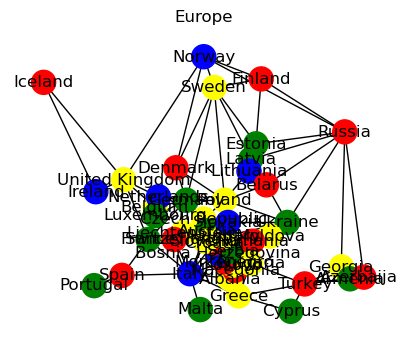

Generation Number: 10 

Fitness: 96 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'yellow'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'yellow'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'yellow'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'red'), ('Bulgaria', 'yellow'), ('Cyprus', 'green'), ('Turkey', 'red'), 

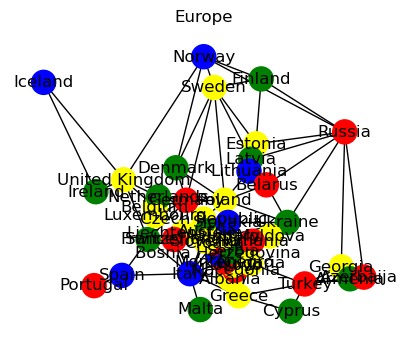

Generation Number: 20 

Fitness: 97 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'yellow'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'yellow'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'red'), ('Bulgaria', 'yellow'), ('Cyprus', 'green'), ('Turkey', 'red'), ('

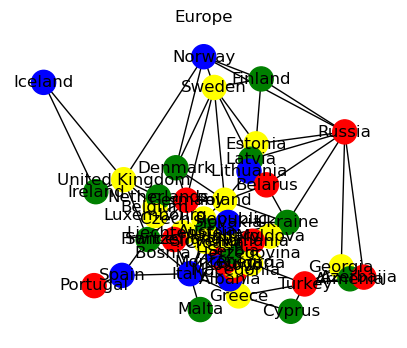

Generation Number: 30 

Fitness: 97 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'yellow'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'red'), ('Bulgaria', 'yellow'), ('Cyprus', 'green'), ('Turkey', 'red'), ('G

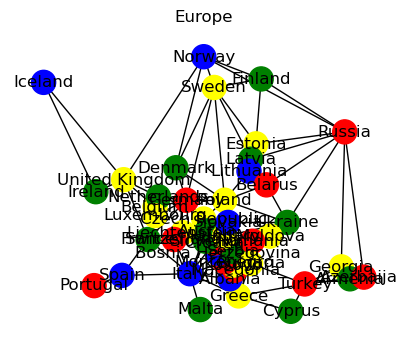

Generation Number: 40 

Fitness: 97 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'yellow'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'green'), ('Turkey', 'red'), ('

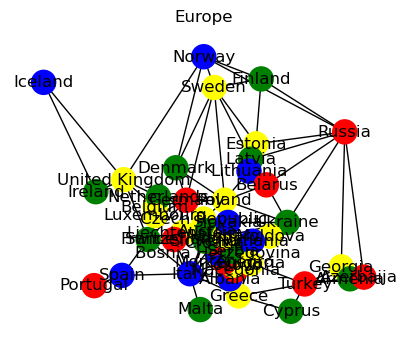

Generation Number: 50 

Fitness: 98 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'yellow'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'green'), ('Turkey', 'red'), ('G

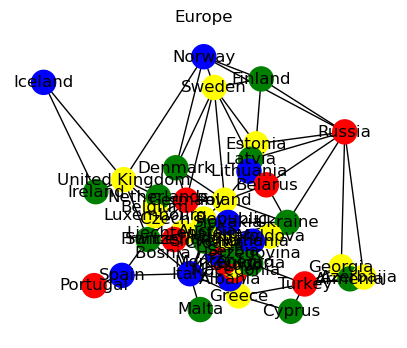

Generation Number: 60 

Fitness: 98 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'green'), ('Turkey', 'red'), ('Geor

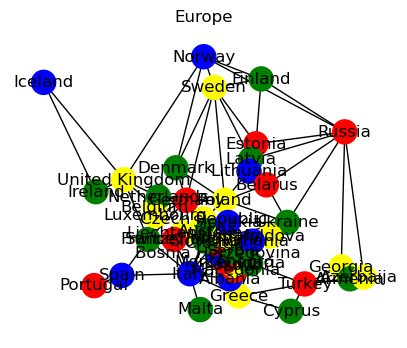

Generation Number: 70 

Fitness: 98 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'red'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'yellow'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'yellow'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'green'), ('Turkey', 'red'), ('Geor

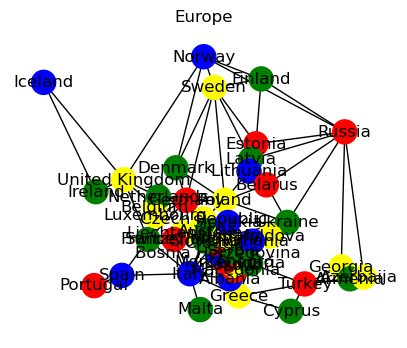

Generation Number: 80 

Fitness: 99 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'green'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia'

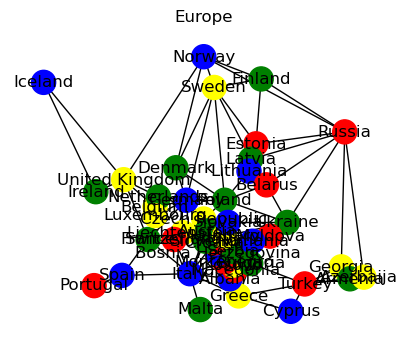

Generation Number: 90 

Fitness: 99 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'green'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia'

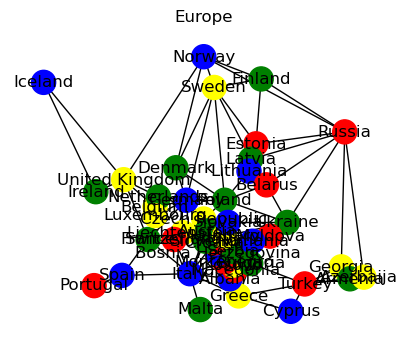

Generation Number: 100 

Fitness: 99 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'green'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia

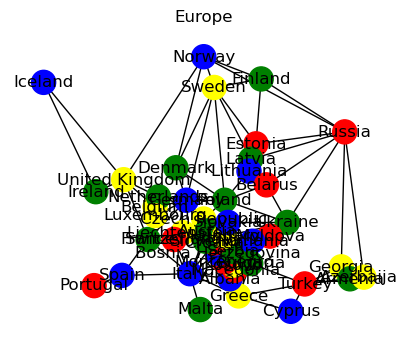

Generation Number: 110 

Fitness: 100 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia'

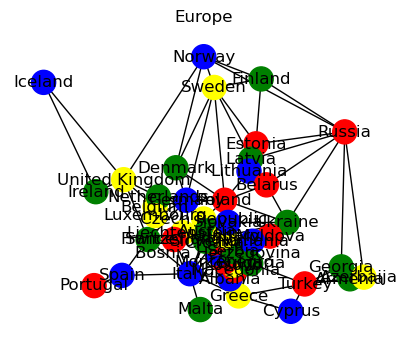

Generation Number: 120 

Fitness: 100 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'yellow'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'green'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia',

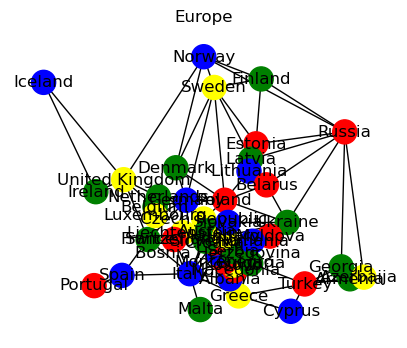

Generation Number: 130 

Fitness: 100 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

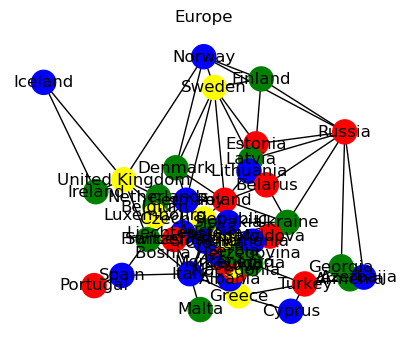

Generation Number: 140 

Fitness: 102 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

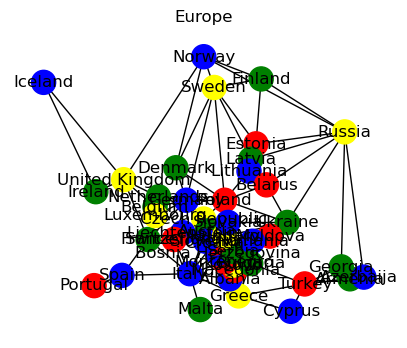

Generation Number: 150 

Fitness: 102 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

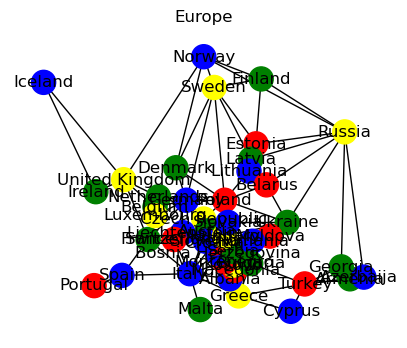

Generation Number: 160 

Fitness: 102 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

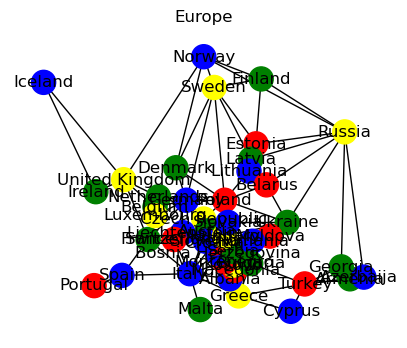

Generation Number: 170 

Fitness: 102 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

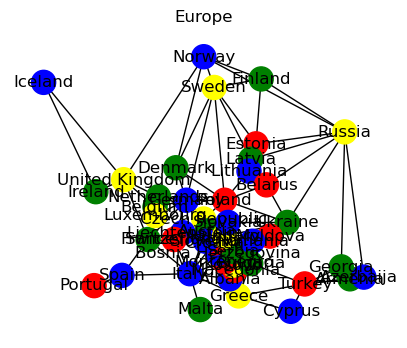

Generation Number: 180 

Fitness: 102 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'red'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

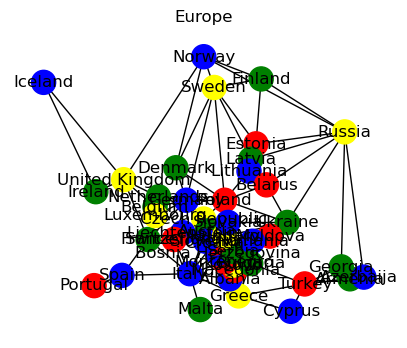

Generation Number: 190 

Fitness: 102 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'yellow'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'green'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 

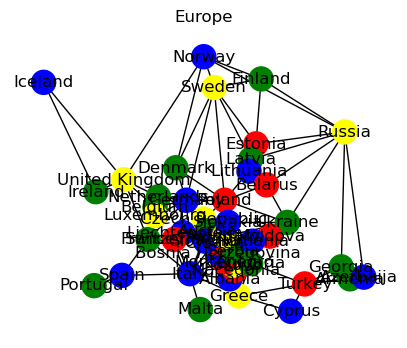

Generation Number: 200 

Fitness: 103 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

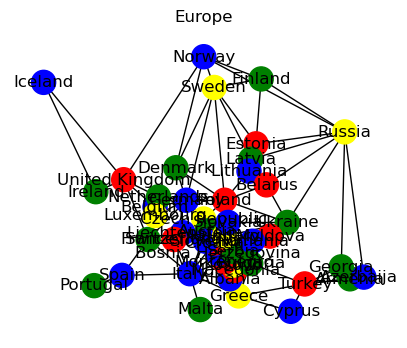

Generation Number: 210 

Fitness: 103 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

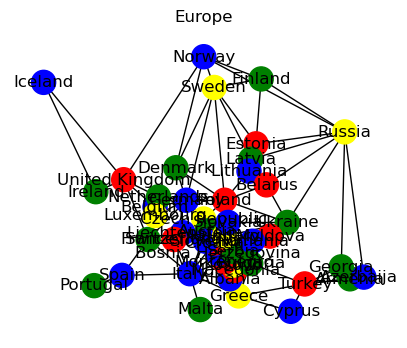

Generation Number: 220 

Fitness: 103 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

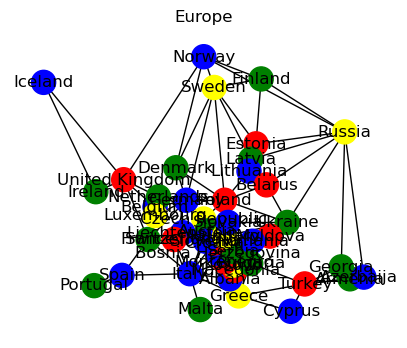

Generation Number: 230 

Fitness: 103 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

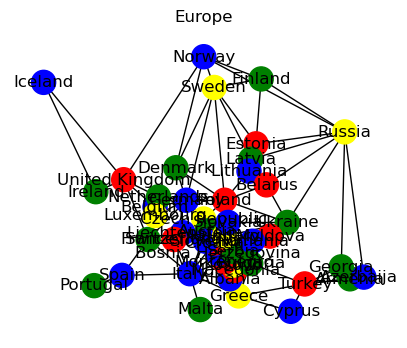

Generation Number: 240 

Fitness: 103 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

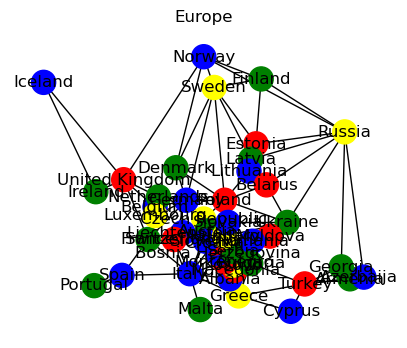

Generation Number: 250 

Fitness: 104 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'blue'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'green'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gr

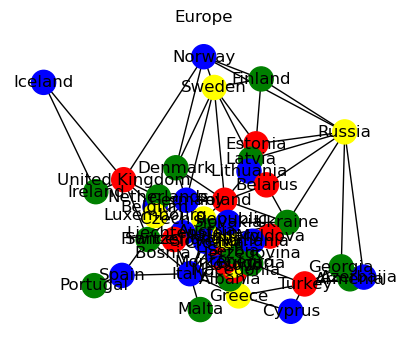

Generation Number: 260 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'green'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

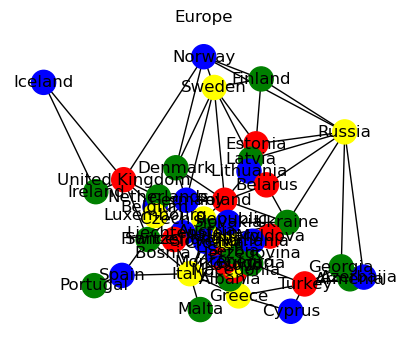

Generation Number: 270 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'green'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

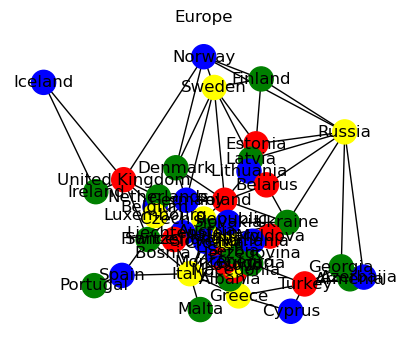

Generation Number: 280 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'green'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

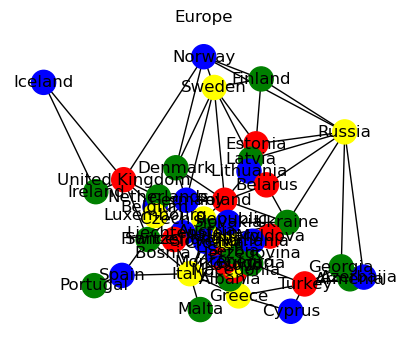

Generation Number: 290 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'green'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

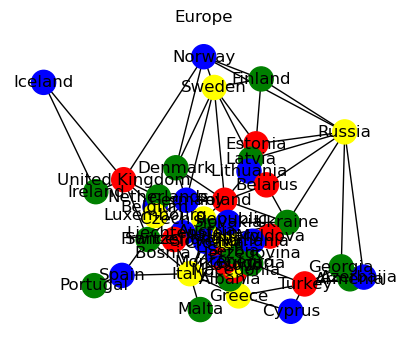

Generation Number: 300 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

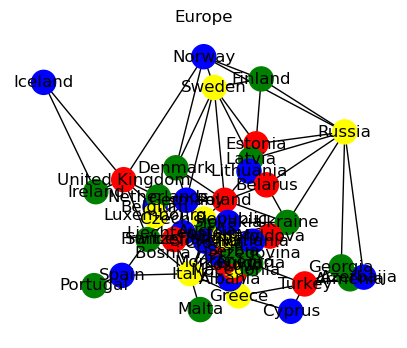

Generation Number: 310 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

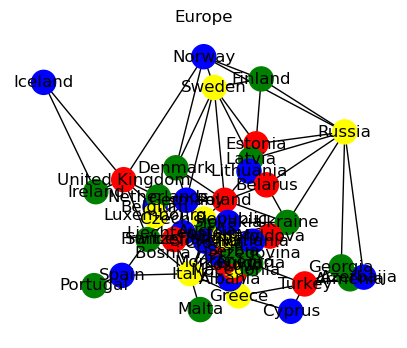

Generation Number: 320 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

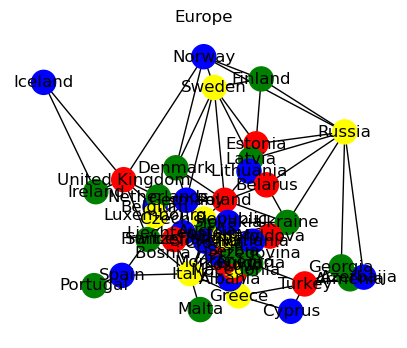

Generation Number: 330 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

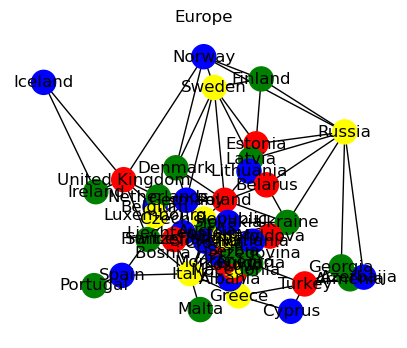

Generation Number: 340 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

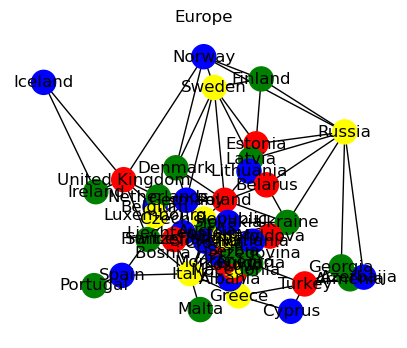

Generation Number: 350 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

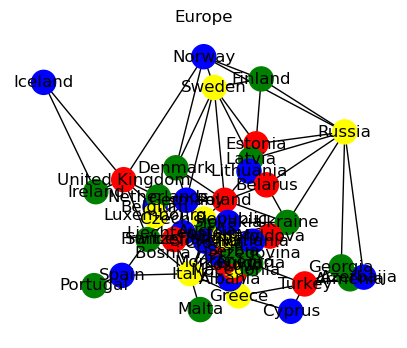

Generation Number: 360 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

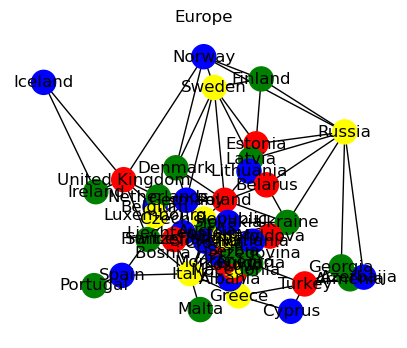

Generation Number: 370 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'yellow'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

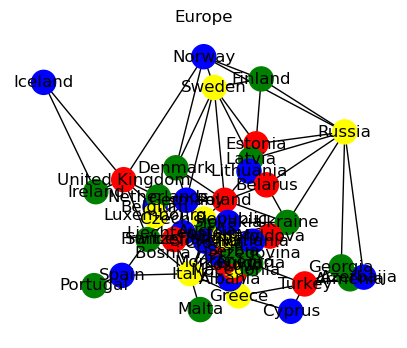

Generation Number: 380 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

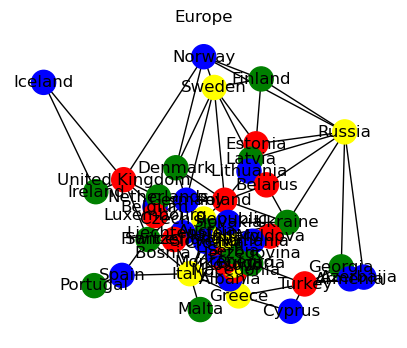

Generation Number: 390 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

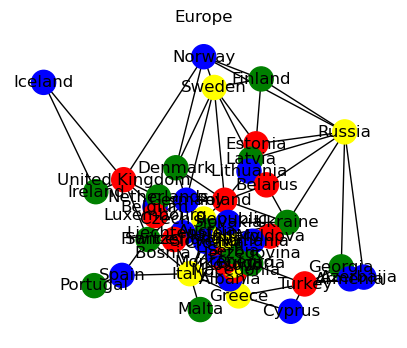

Generation Number: 400 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

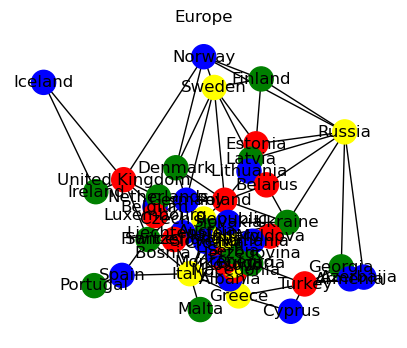

Generation Number: 410 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

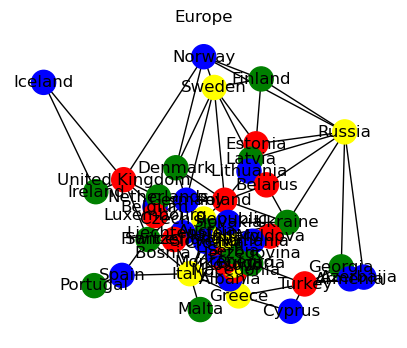

Generation Number: 420 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

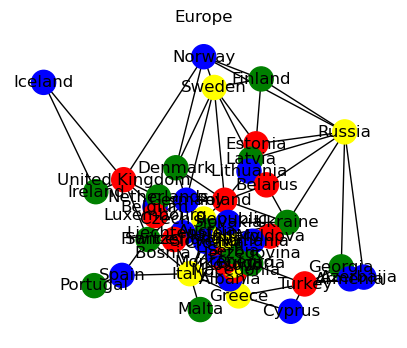

Generation Number: 430 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

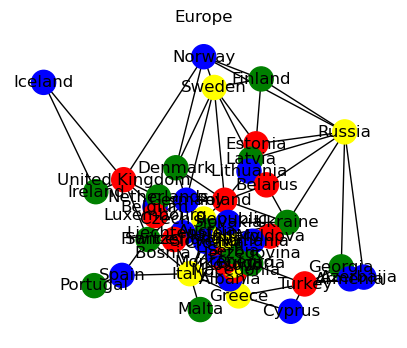

Generation Number: 440 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

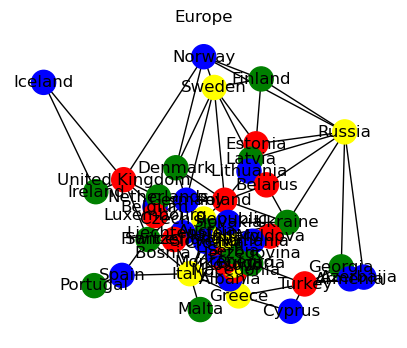

Generation Number: 450 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

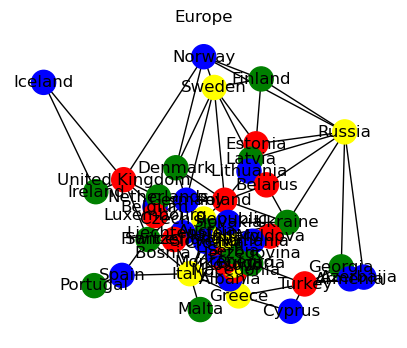

Generation Number: 460 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

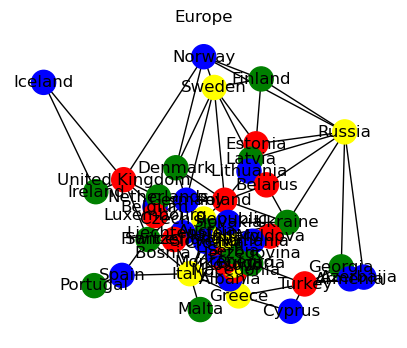

Generation Number: 470 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

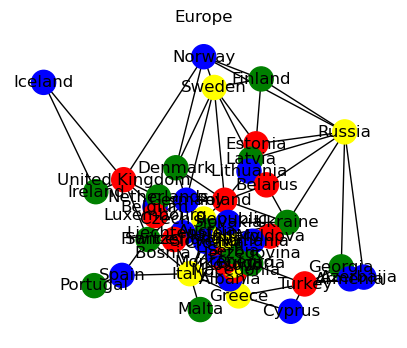

Generation Number: 480 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

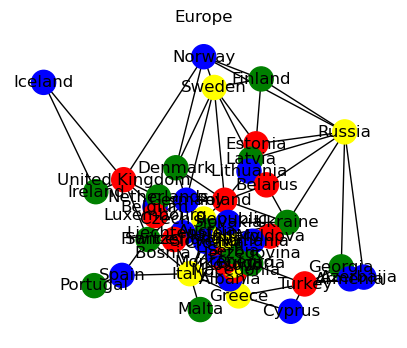

Generation Number: 490 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

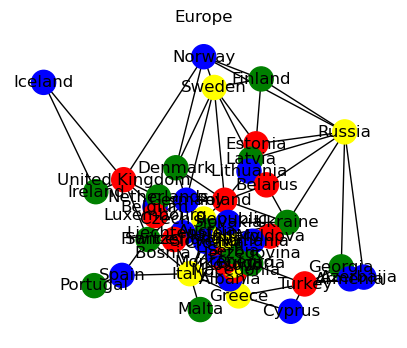

Generation Number: 500 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

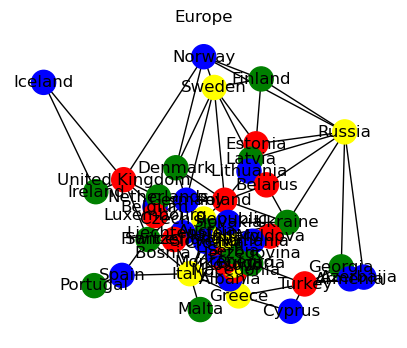

Generation Number: 510 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'yellow'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

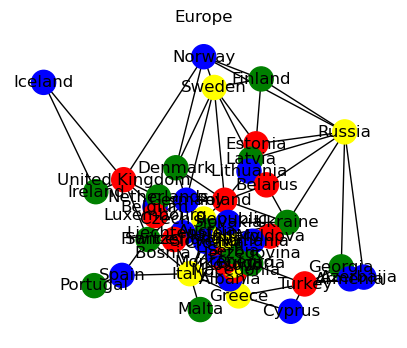

Generation Number: 520 

Fitness: 106 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'blue'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'green

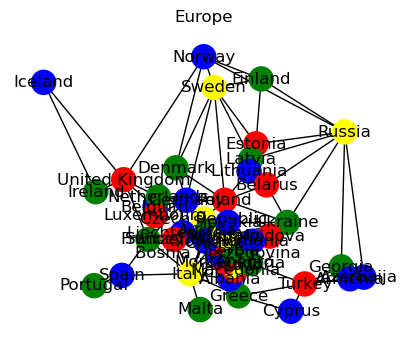

Generation Number: 530 

Fitness: 107 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

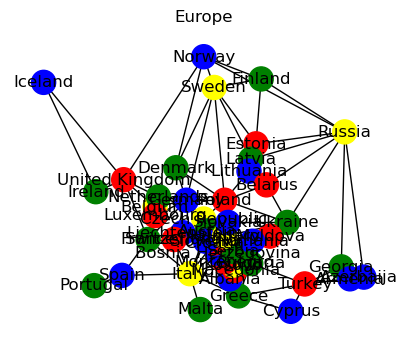

Generation Number: 540 

Fitness: 107 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'green'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

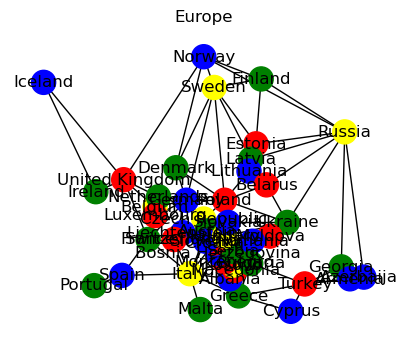

Generation Number: 550 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

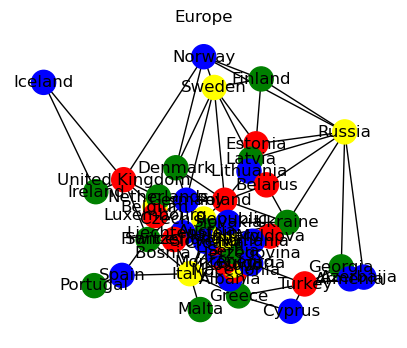

Generation Number: 560 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

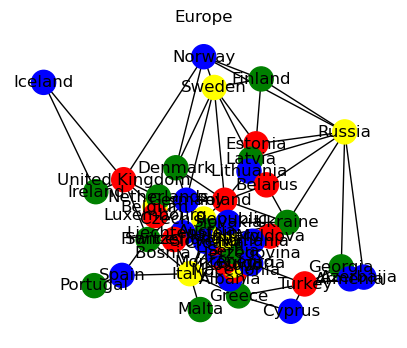

Generation Number: 570 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

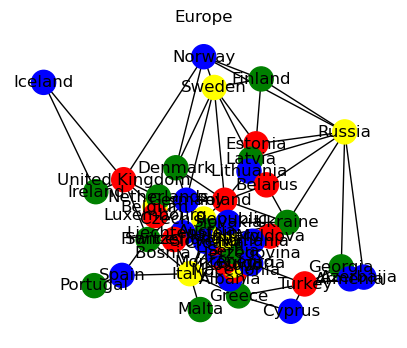

Generation Number: 580 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

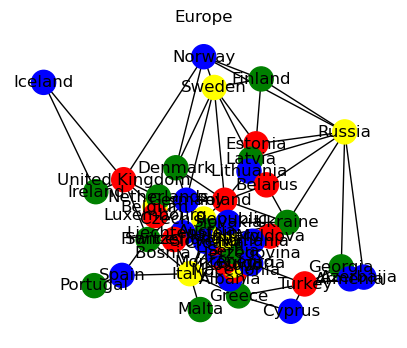

Generation Number: 590 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'green'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gree

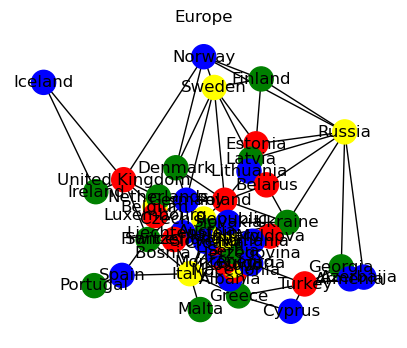

Generation Number: 600 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'green

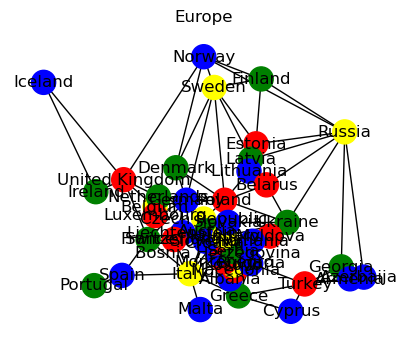

Generation Number: 610 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'green

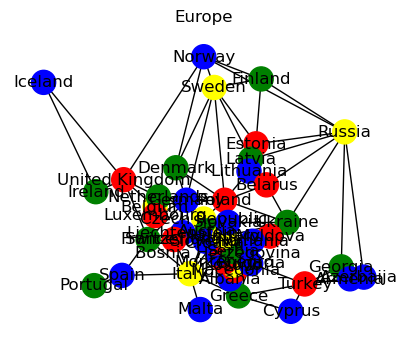

Generation Number: 620 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'green

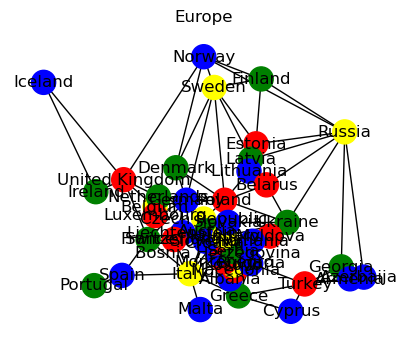

Generation Number: 630 

Fitness: 108 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'blue'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'green

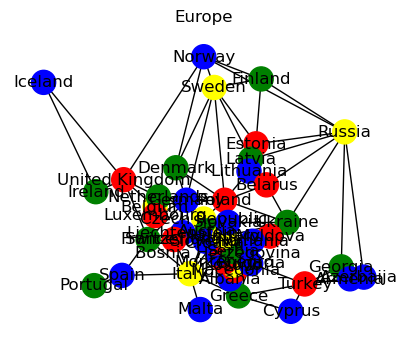

Generation Number: 640 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

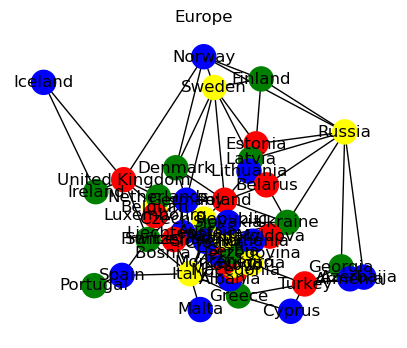

Generation Number: 650 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

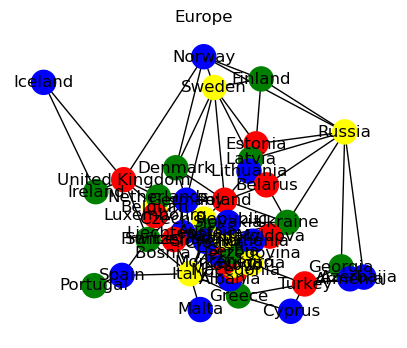

Generation Number: 660 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

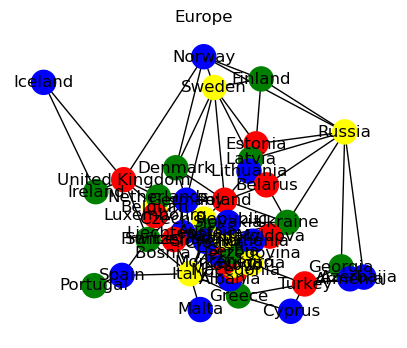

Generation Number: 670 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

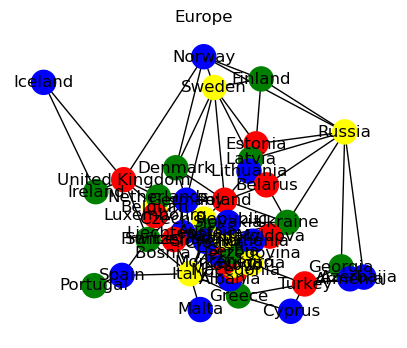

Generation Number: 680 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

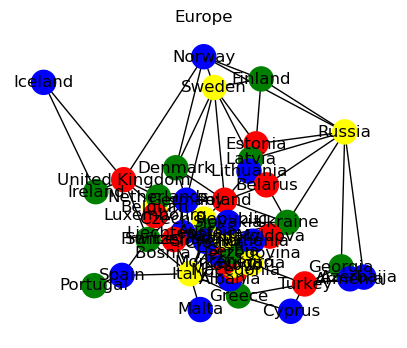

Generation Number: 690 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

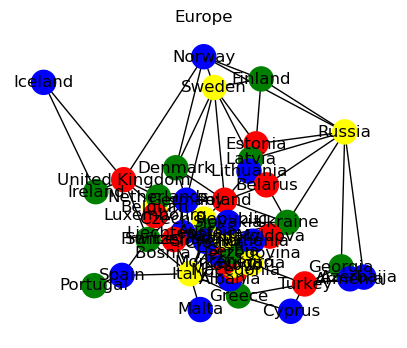

Generation Number: 700 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

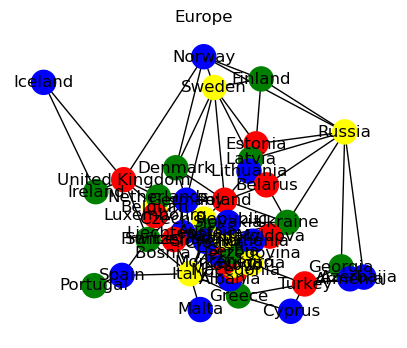

Generation Number: 710 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

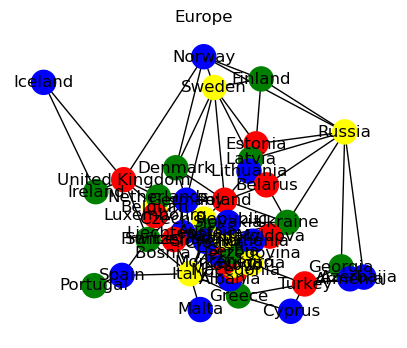

Generation Number: 720 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

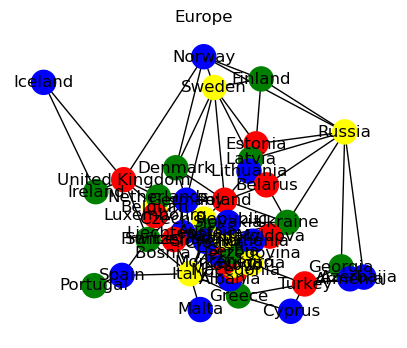

Generation Number: 730 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

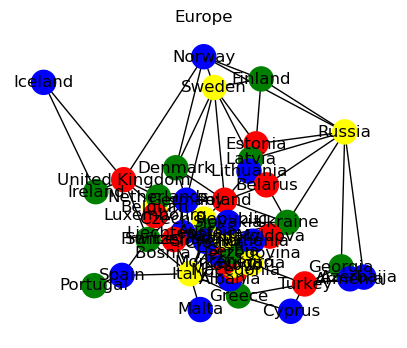

Generation Number: 740 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

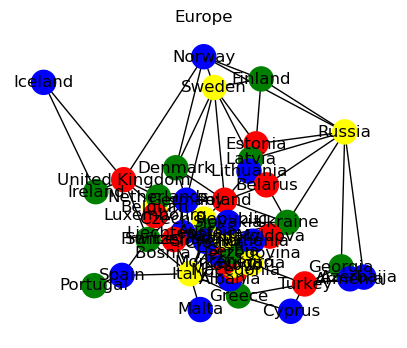

Generation Number: 750 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

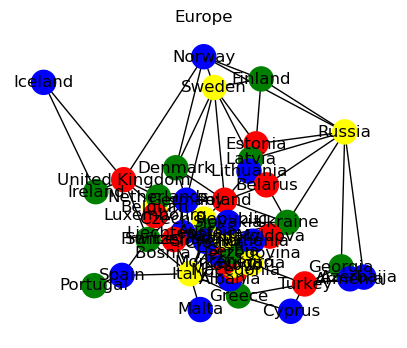

Generation Number: 760 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

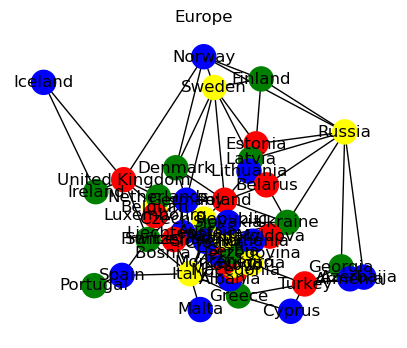

Generation Number: 770 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

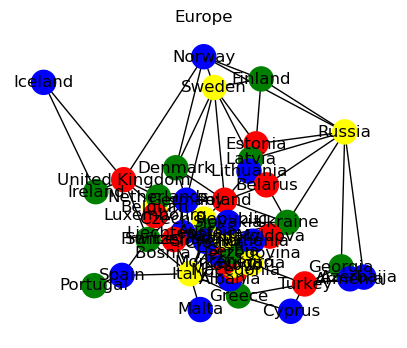

Generation Number: 780 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

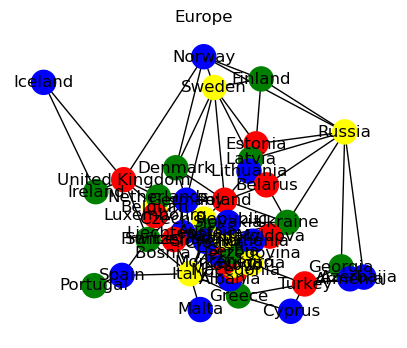

Generation Number: 790 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

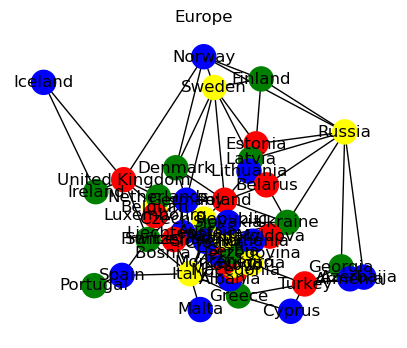

Generation Number: 800 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

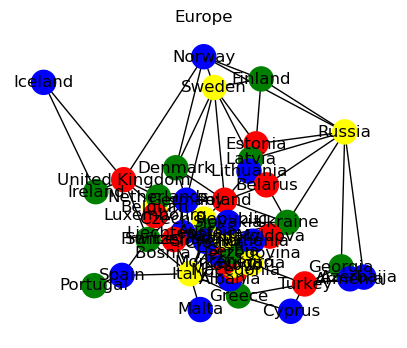

Generation Number: 810 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

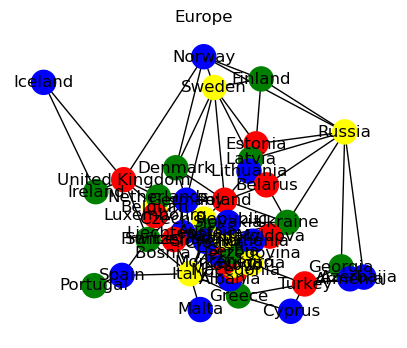

Generation Number: 820 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

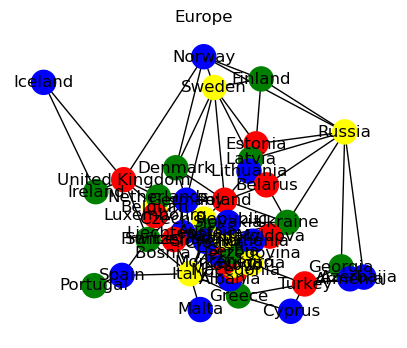

Generation Number: 830 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

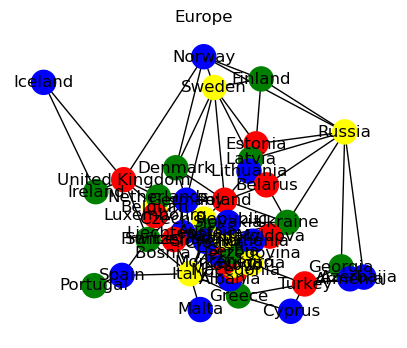

Generation Number: 840 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

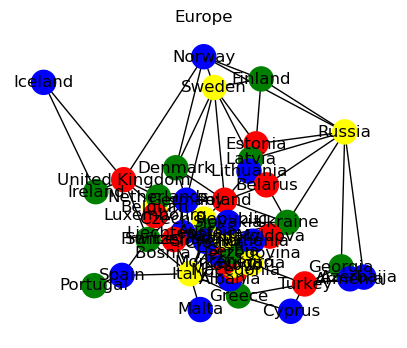

Generation Number: 850 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

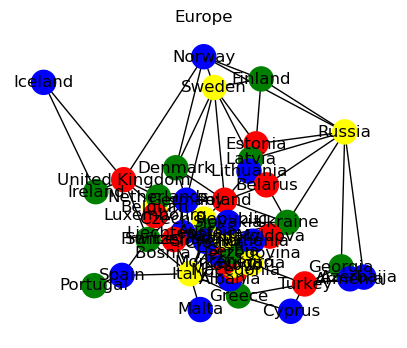

Generation Number: 860 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

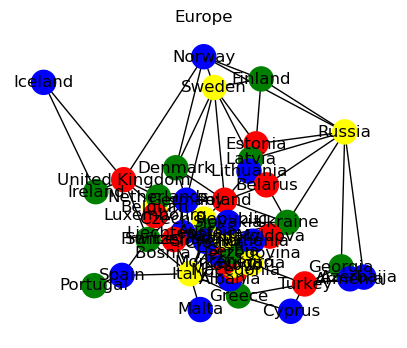

Generation Number: 870 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

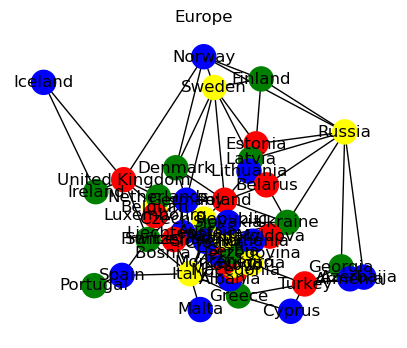

Generation Number: 880 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

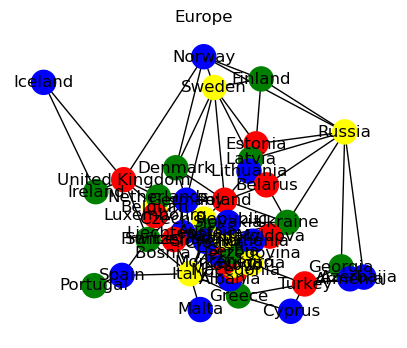

Generation Number: 890 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

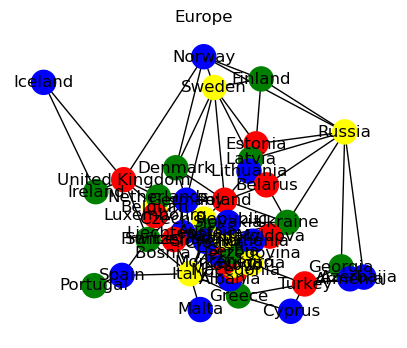

Generation Number: 900 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

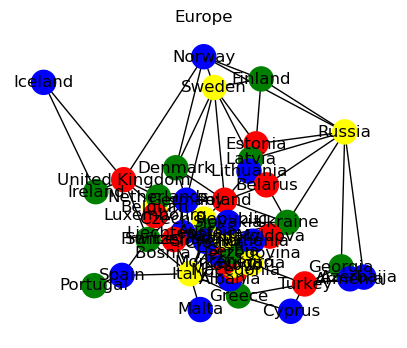

Generation Number: 910 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

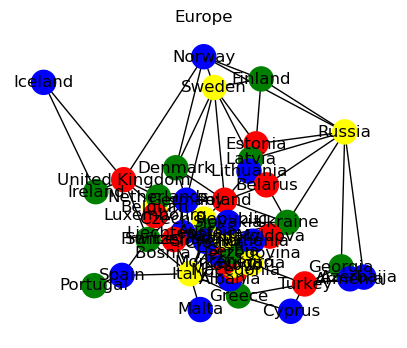

Generation Number: 920 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

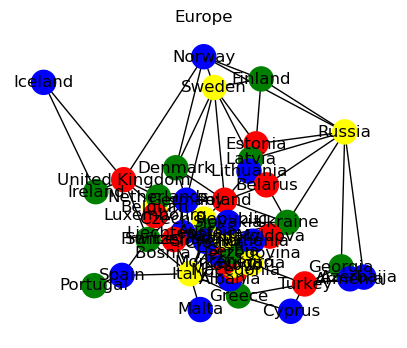

Generation Number: 930 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

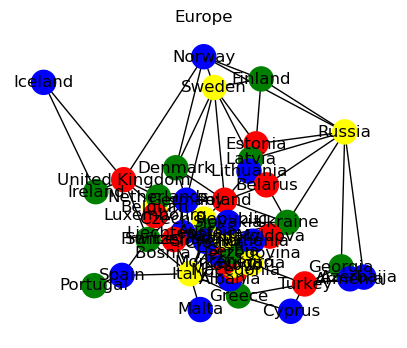

Generation Number: 940 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

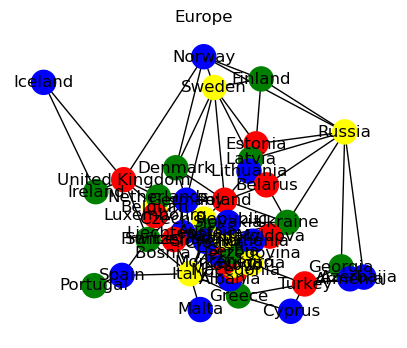

Generation Number: 950 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

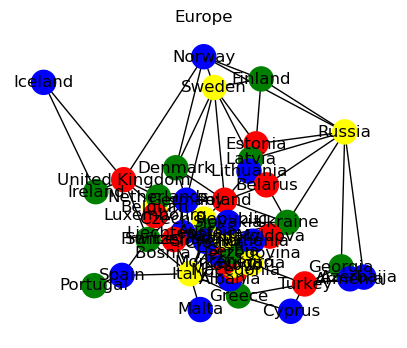

Generation Number: 960 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

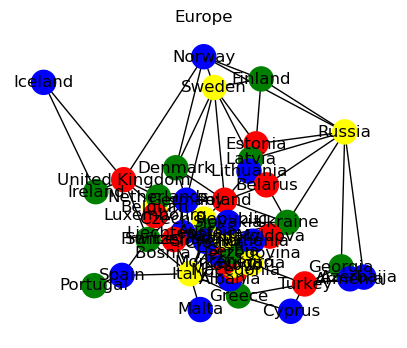

Generation Number: 970 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

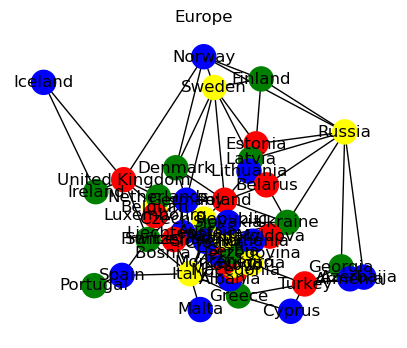

Generation Number: 980 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

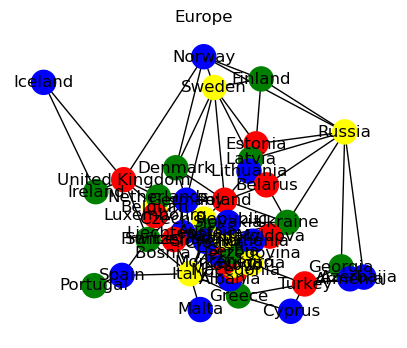

Generation Number: 990 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'red'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'gre

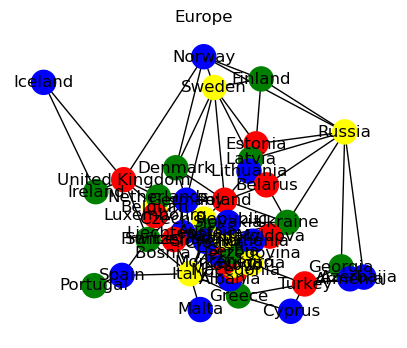

Generation Number: 1000 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

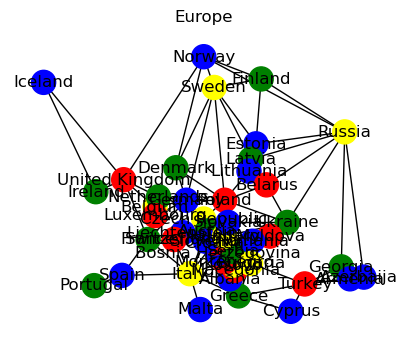

Generation Number: 1010 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

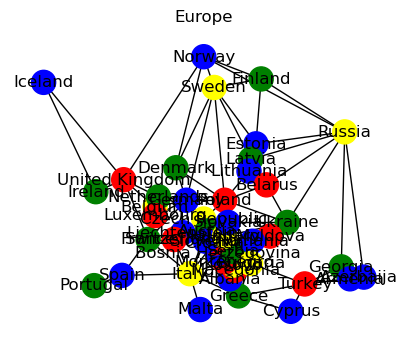

Generation Number: 1020 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

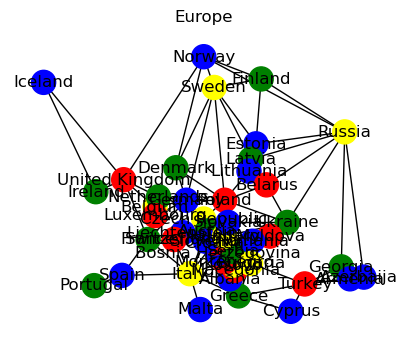

Generation Number: 1030 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

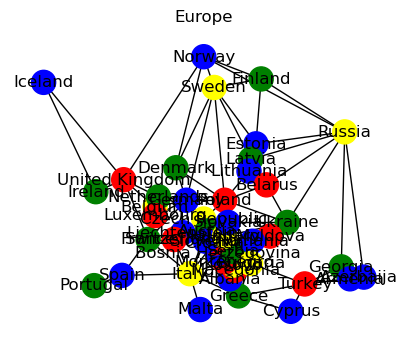

Generation Number: 1040 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

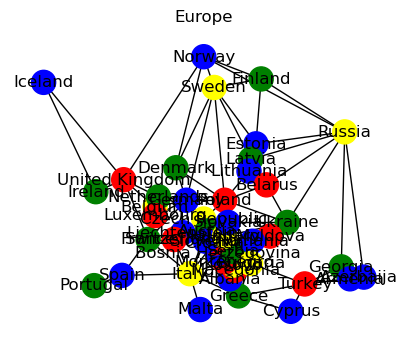

Generation Number: 1050 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

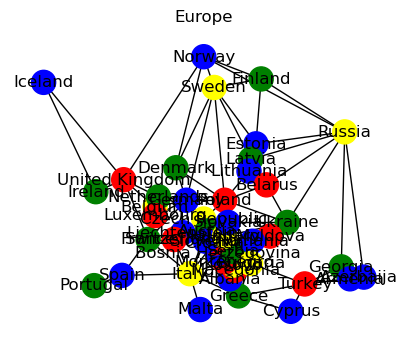

Generation Number: 1060 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

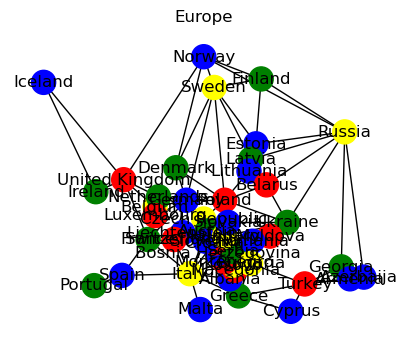

Generation Number: 1070 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

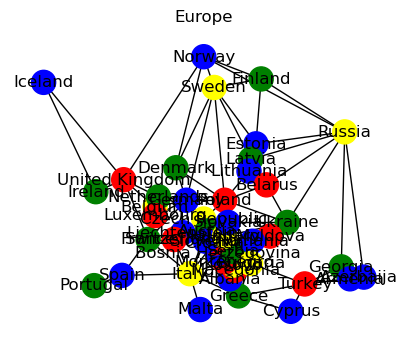

Generation Number: 1080 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

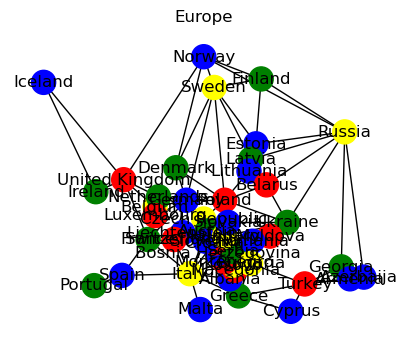

Generation Number: 1090 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

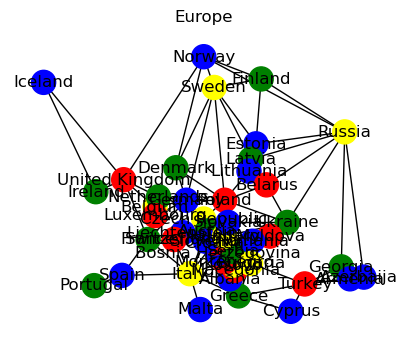

Generation Number: 1100 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

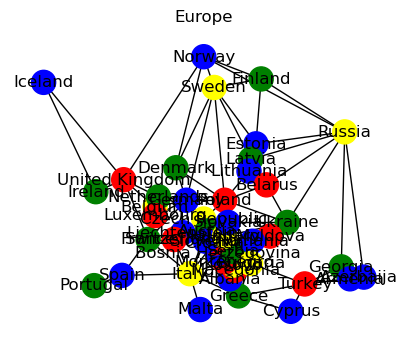

Generation Number: 1110 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

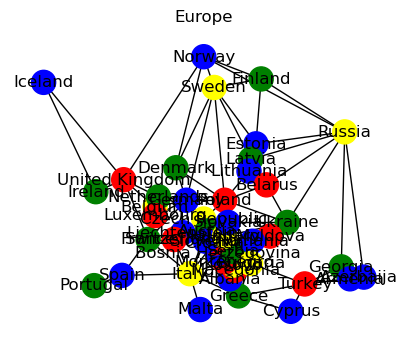

Generation Number: 1120 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

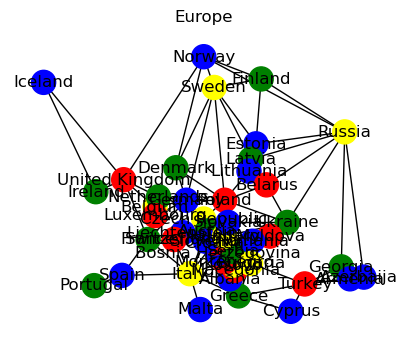

Generation Number: 1130 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

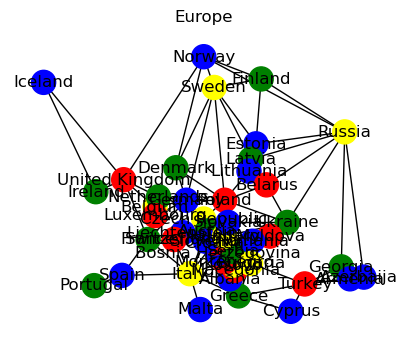

Generation Number: 1140 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

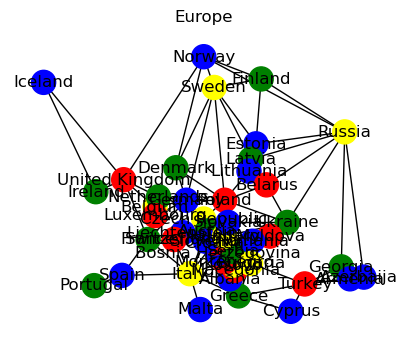

Generation Number: 1150 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

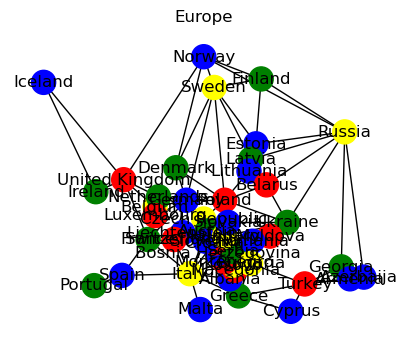

Generation Number: 1160 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

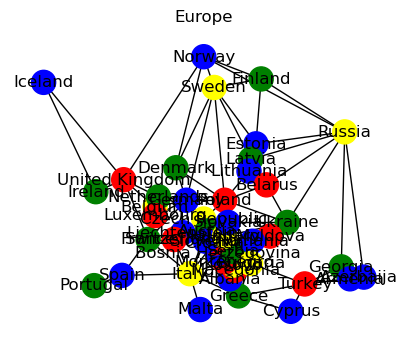

Generation Number: 1170 

Fitness: 109 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

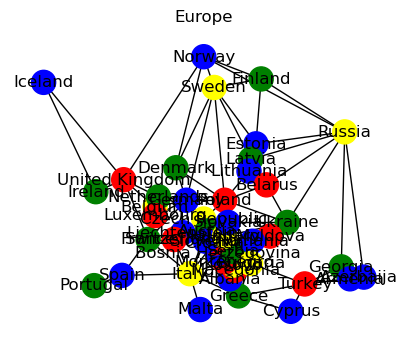

Generation Number: 1180 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

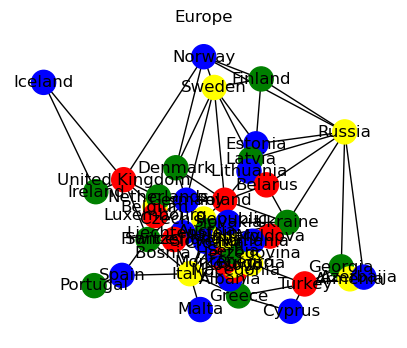

Generation Number: 1190 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

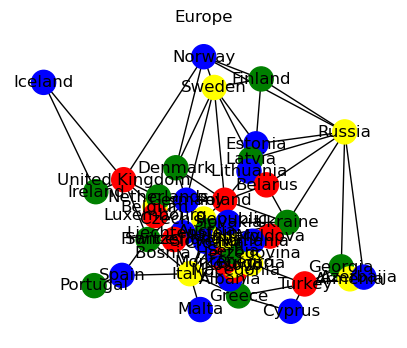

Generation Number: 1200 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

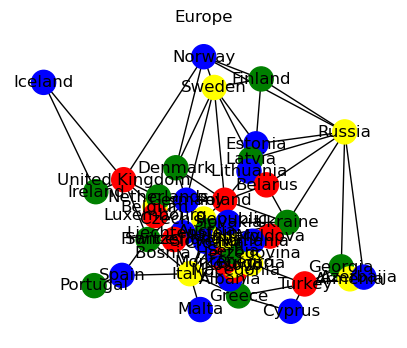

Generation Number: 1210 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

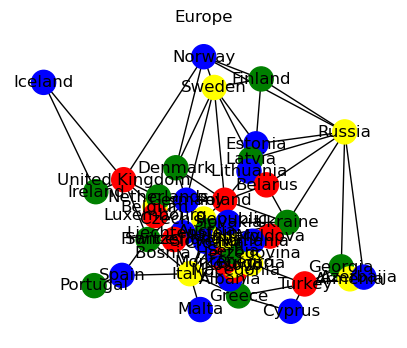

Generation Number: 1220 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

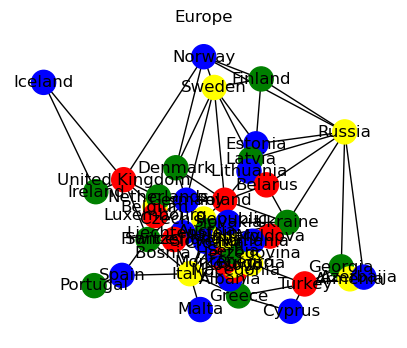

Generation Number: 1230 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

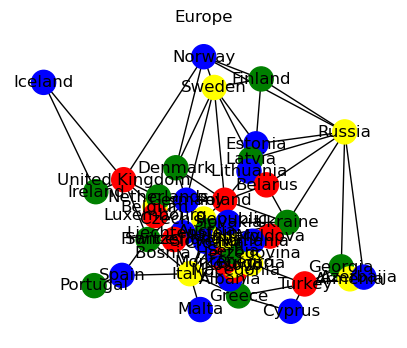

Generation Number: 1240 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

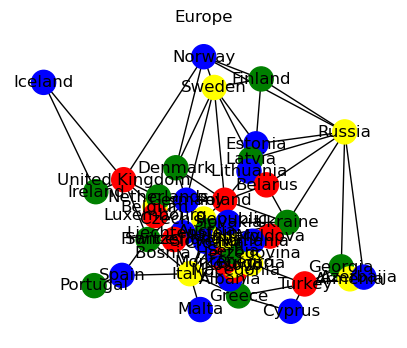

Generation Number: 1250 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

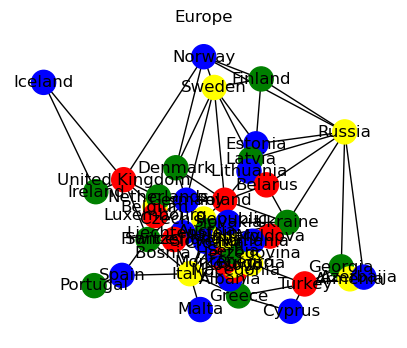

Generation Number: 1260 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

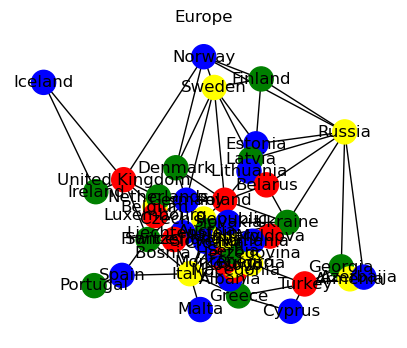

Generation Number: 1270 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

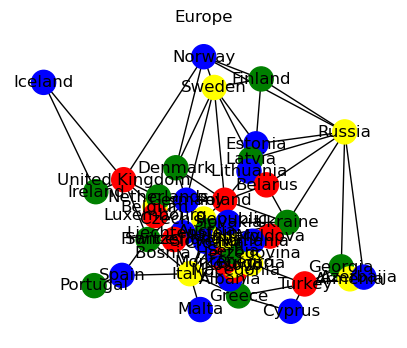

Generation Number: 1280 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

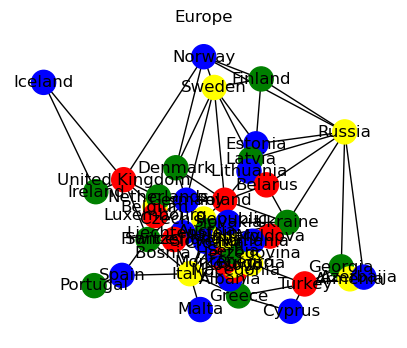

Generation Number: 1290 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

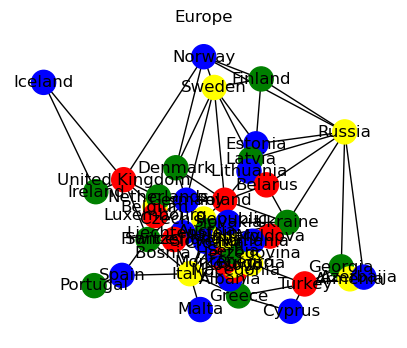

Generation Number: 1300 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

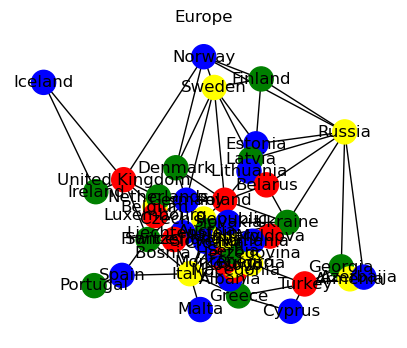

Generation Number: 1310 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

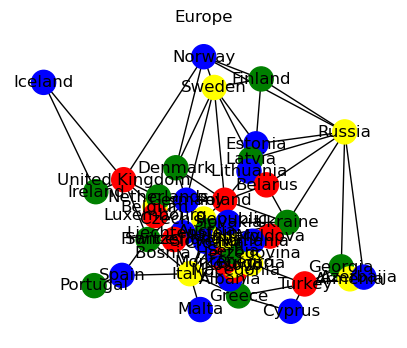

Generation Number: 1320 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

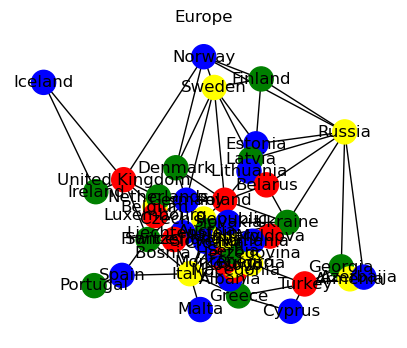

Generation Number: 1330 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

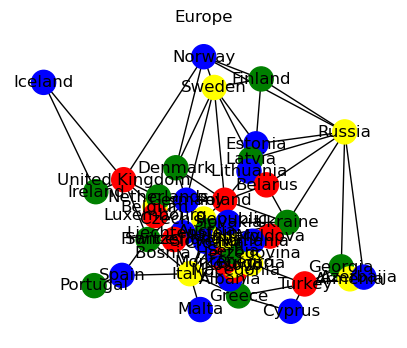

Generation Number: 1340 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

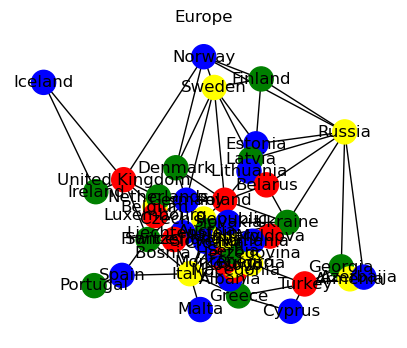

Generation Number: 1350 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

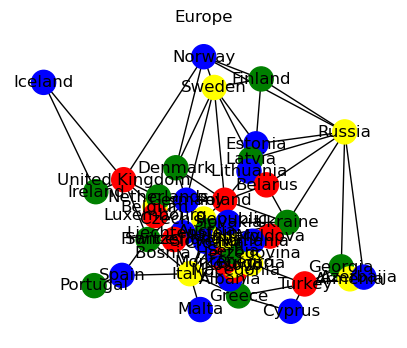

Generation Number: 1360 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

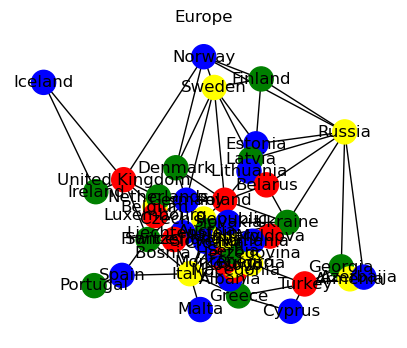

Generation Number: 1370 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

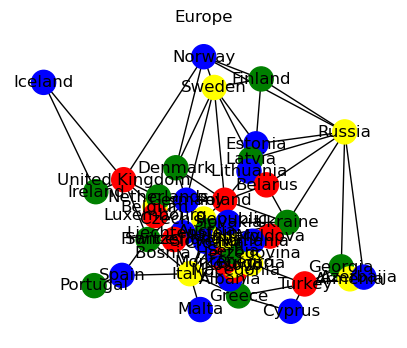

Generation Number: 1380 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

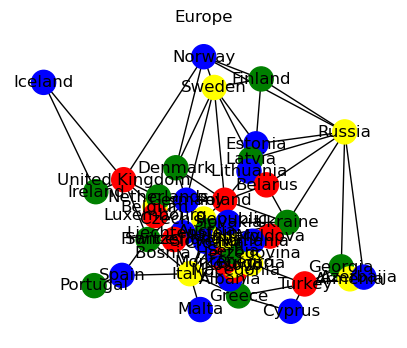

Generation Number: 1390 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

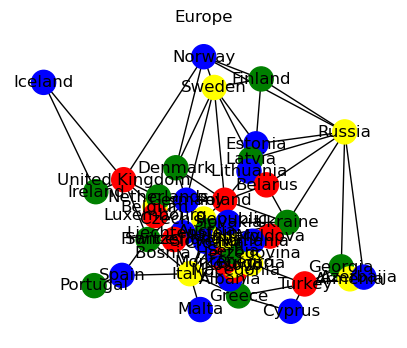

Generation Number: 1400 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

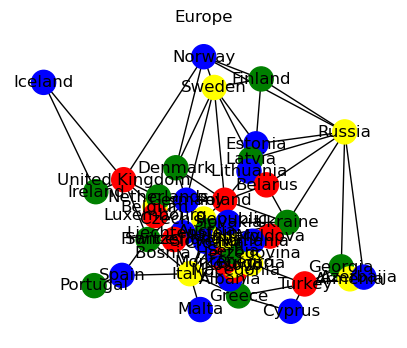

Generation Number: 1410 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

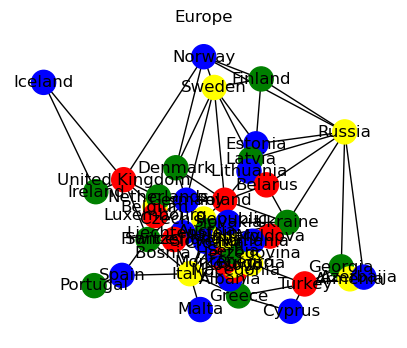

Generation Number: 1420 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

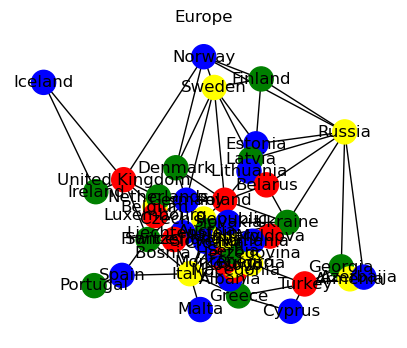

Generation Number: 1430 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

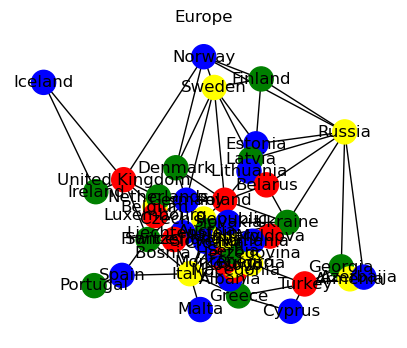

Generation Number: 1440 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

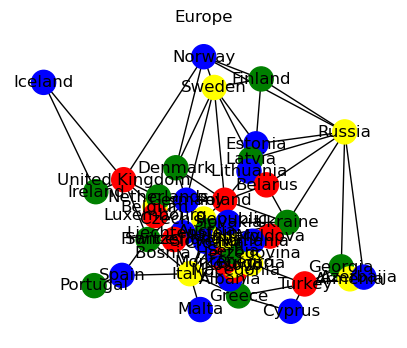

Generation Number: 1450 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

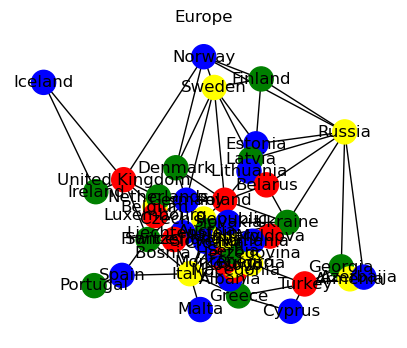

Generation Number: 1460 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

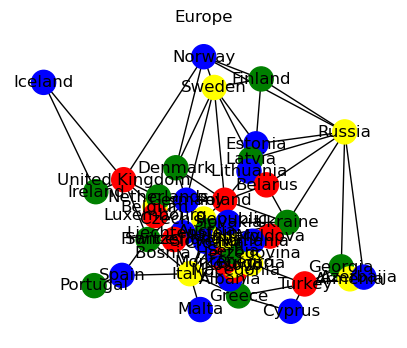

Generation Number: 1470 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

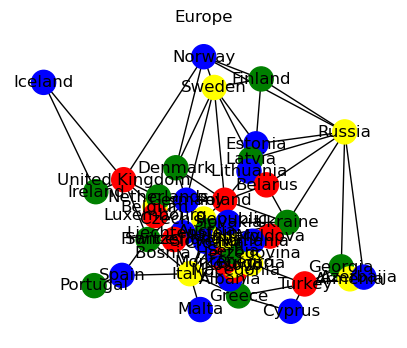

Generation Number: 1480 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

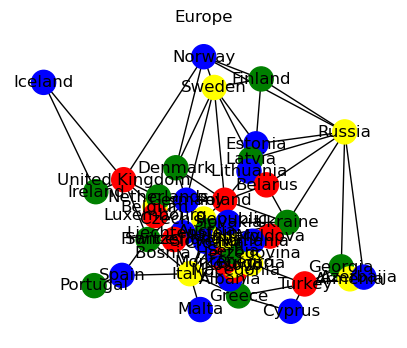

Generation Number: 1490 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

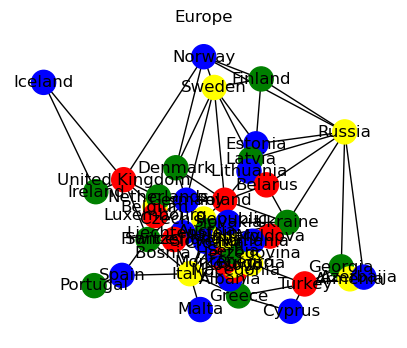

Generation Number: 1500 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

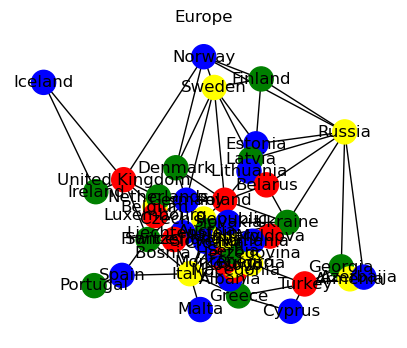

Generation Number: 1510 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

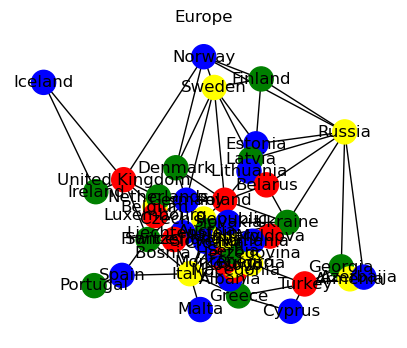

Generation Number: 1520 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

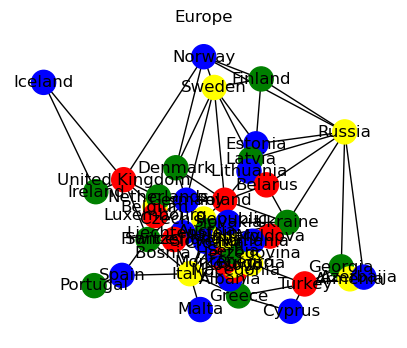

Generation Number: 1530 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

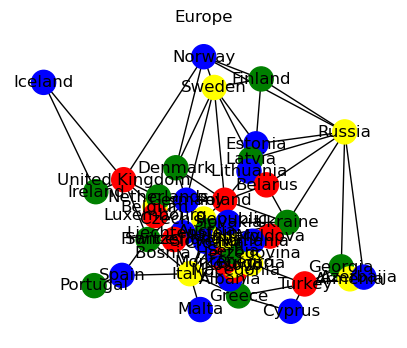

Generation Number: 1540 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

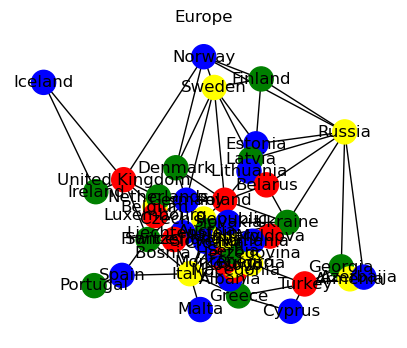

Generation Number: 1550 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

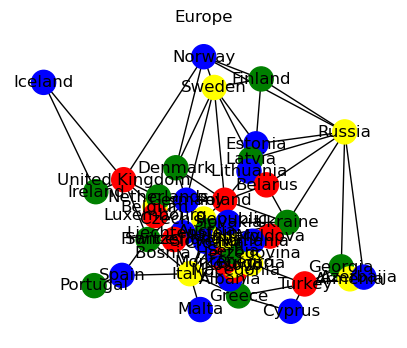

Generation Number: 1560 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

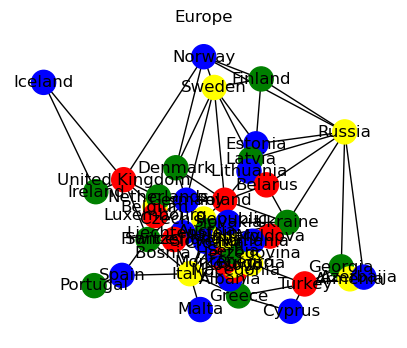

Generation Number: 1570 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

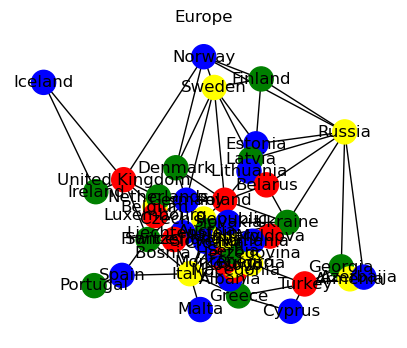

Generation Number: 1580 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

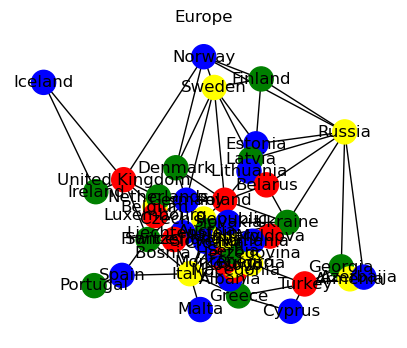

Generation Number: 1590 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

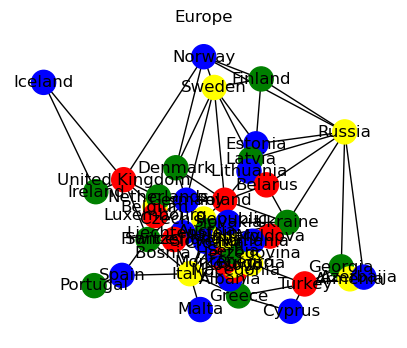

Generation Number: 1600 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

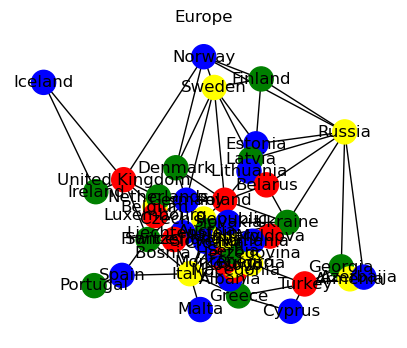

Generation Number: 1610 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

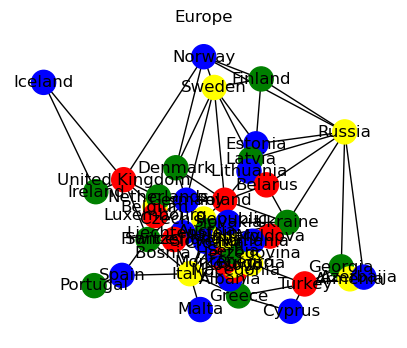

Generation Number: 1620 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

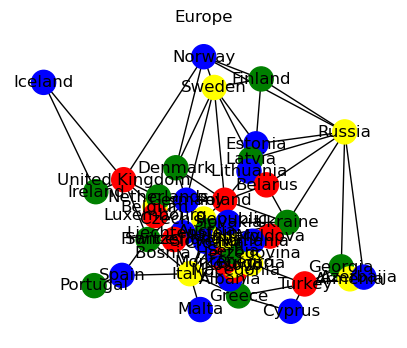

Generation Number: 1630 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

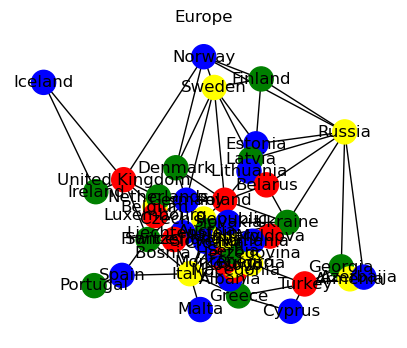

Generation Number: 1640 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

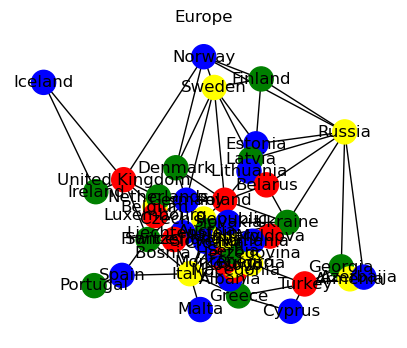

Generation Number: 1650 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

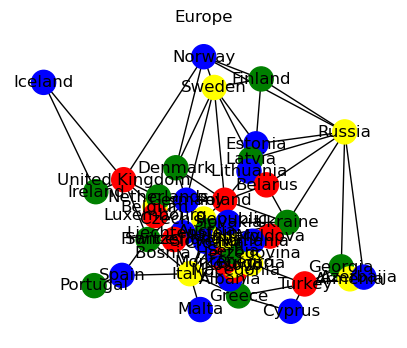

Generation Number: 1660 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

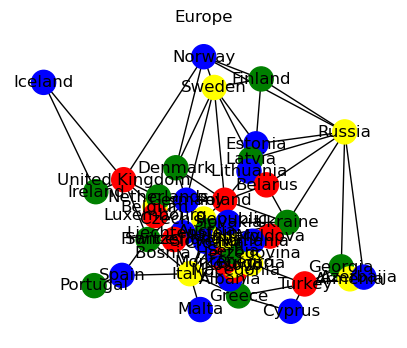

Generation Number: 1670 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

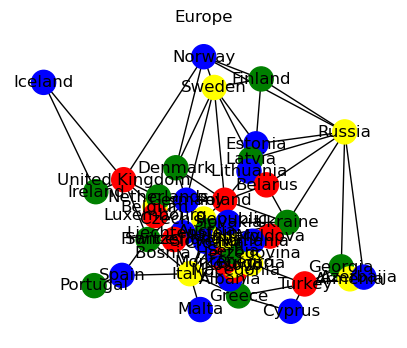

Generation Number: 1680 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

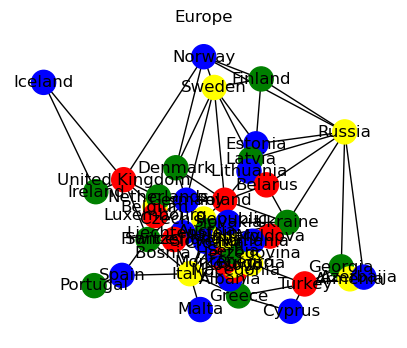

Generation Number: 1690 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

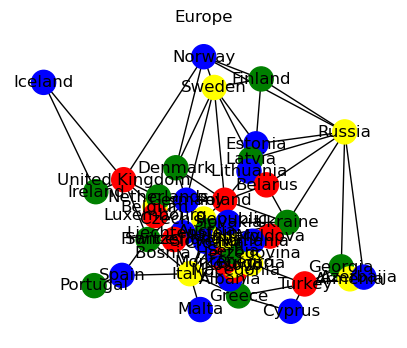

Generation Number: 1700 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

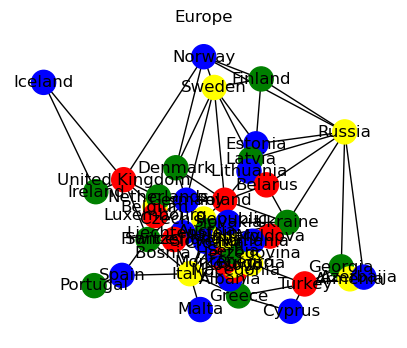

Generation Number: 1710 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

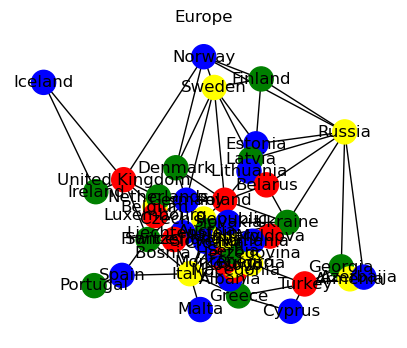

Generation Number: 1720 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

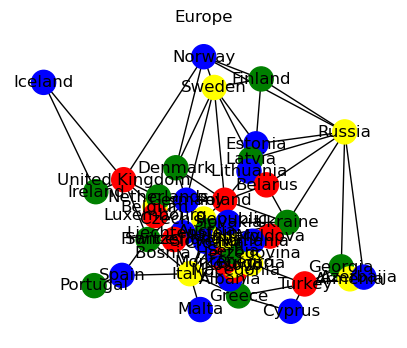

Generation Number: 1730 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

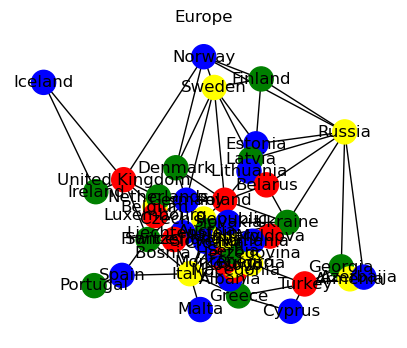

Generation Number: 1740 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

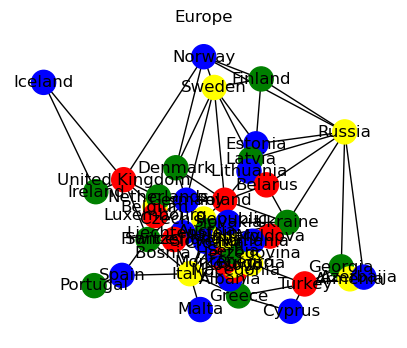

Generation Number: 1750 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

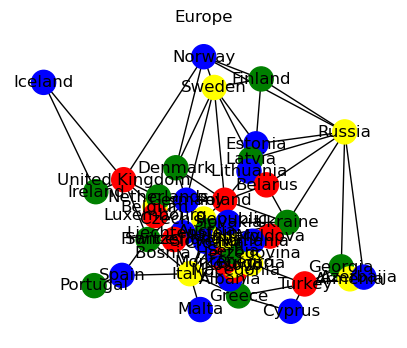

Generation Number: 1760 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

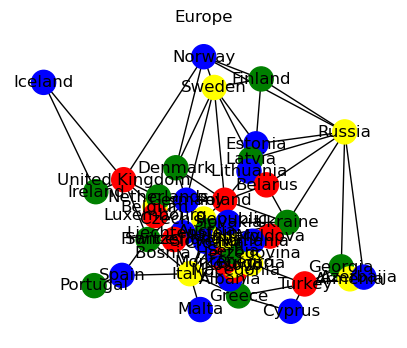

Generation Number: 1770 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

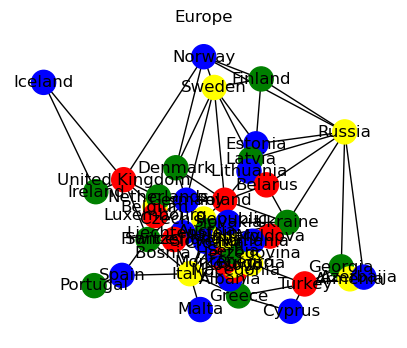

Generation Number: 1780 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

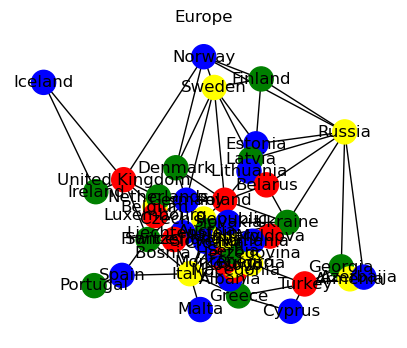

Generation Number: 1790 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'red'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', 'g

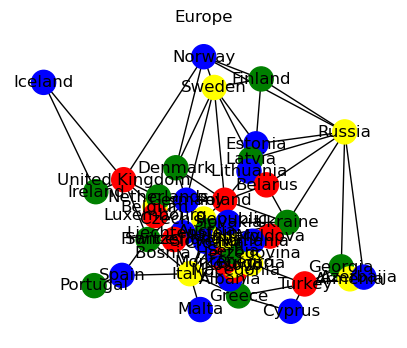

Generation Number: 1800 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

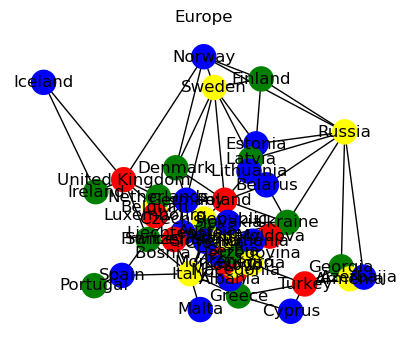

Generation Number: 1810 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

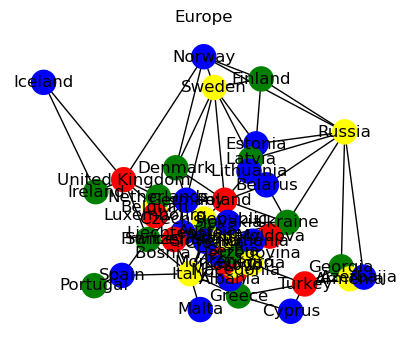

Generation Number: 1820 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

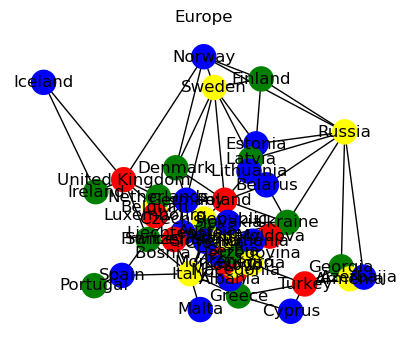

Generation Number: 1830 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

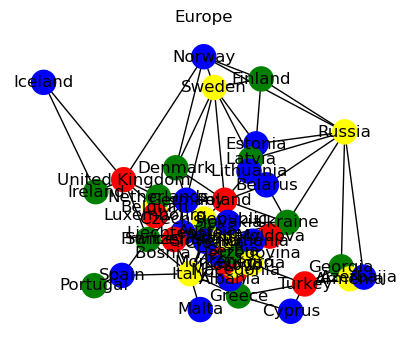

Generation Number: 1840 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

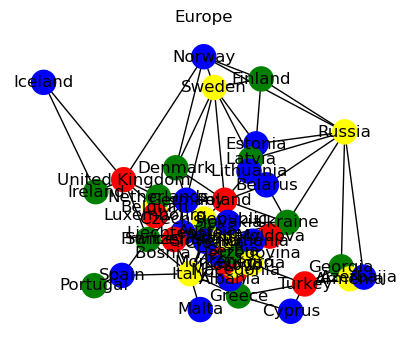

Generation Number: 1850 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

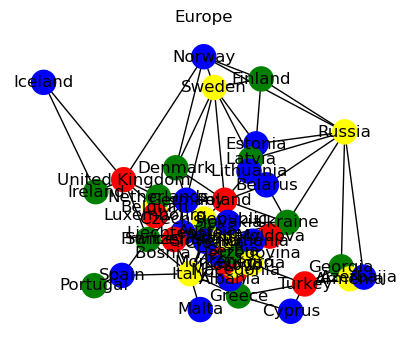

Generation Number: 1860 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

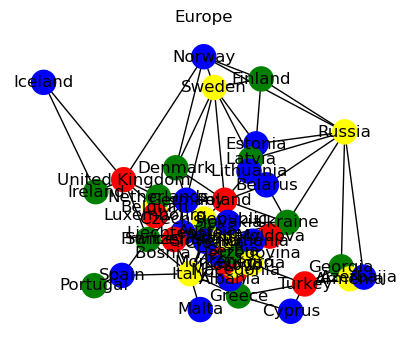

Generation Number: 1870 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

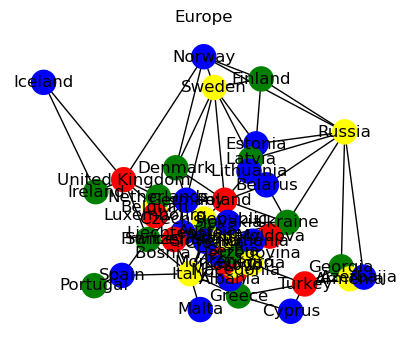

Generation Number: 1880 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

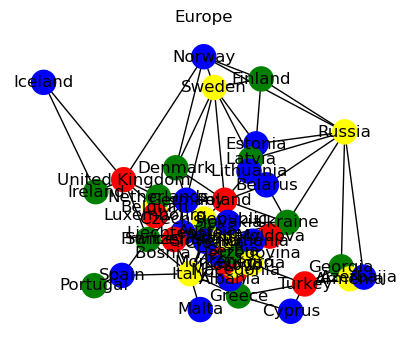

Generation Number: 1890 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

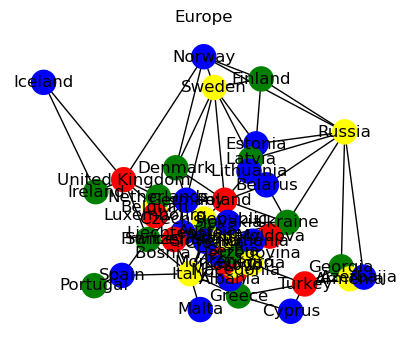

Generation Number: 1900 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

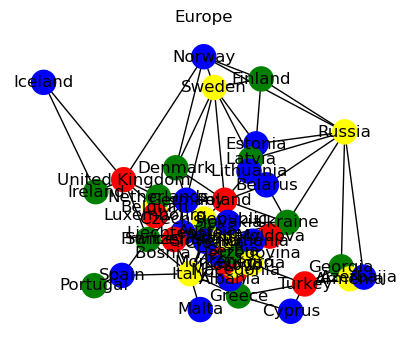

Generation Number: 1910 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

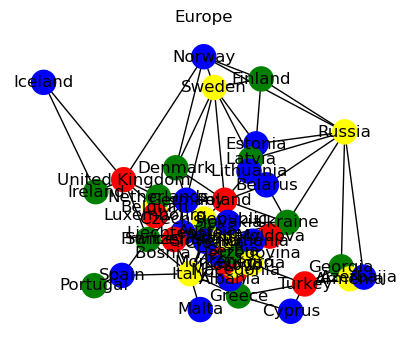

Generation Number: 1920 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

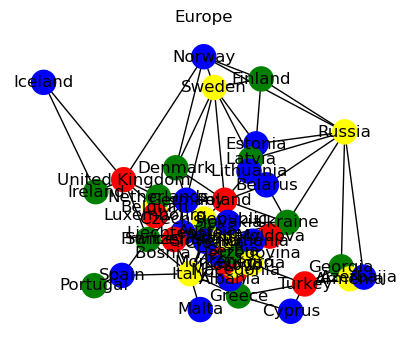

Generation Number: 1930 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

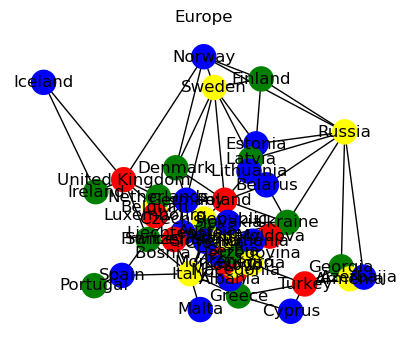

Generation Number: 1940 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

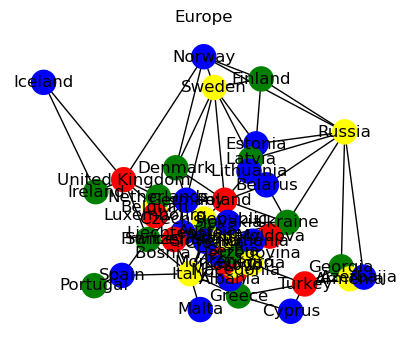

Generation Number: 1950 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

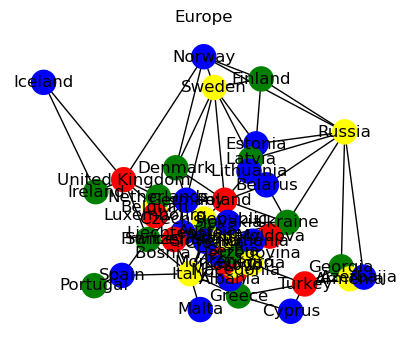

Generation Number: 1960 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

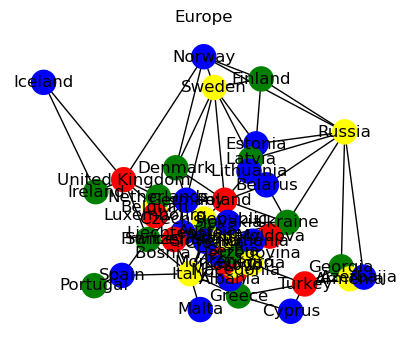

Generation Number: 1970 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

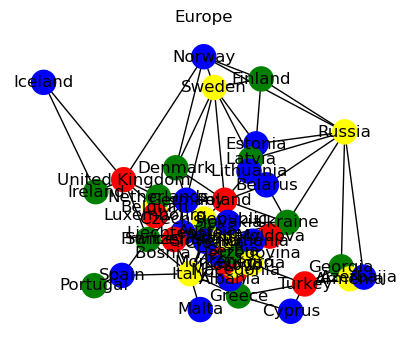

Generation Number: 1980 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

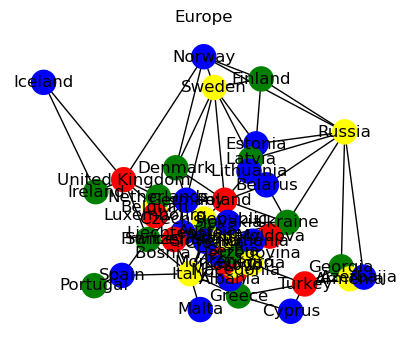

Generation Number: 1990 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

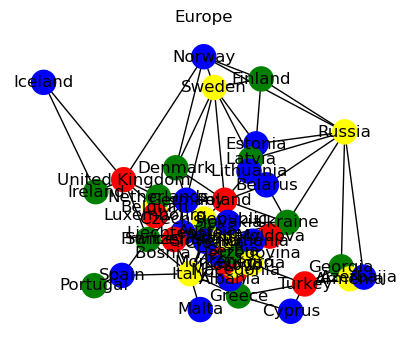

Generation Number: 2000 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

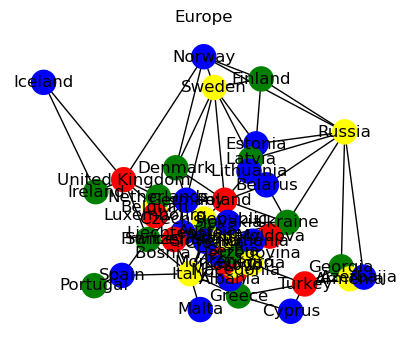

Generation Number: 2010 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

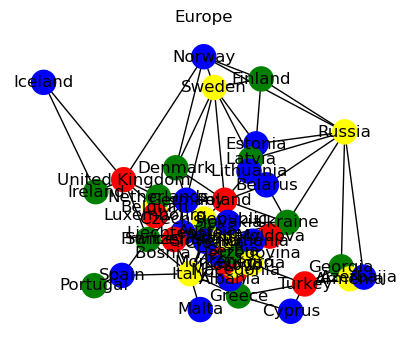

Generation Number: 2020 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

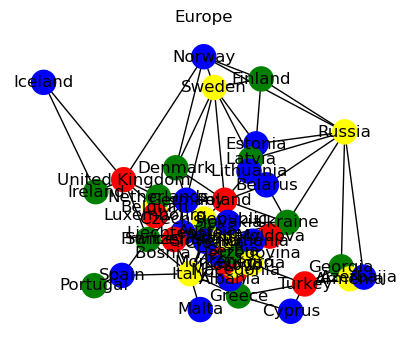

Generation Number: 2030 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

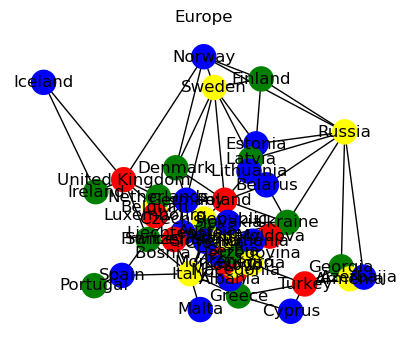

Generation Number: 2040 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

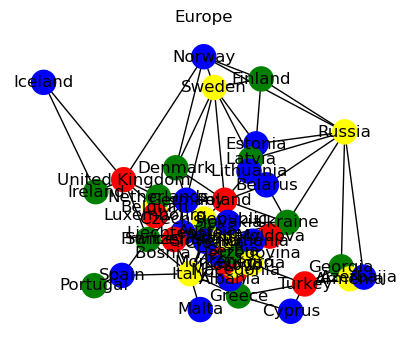

Generation Number: 2050 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

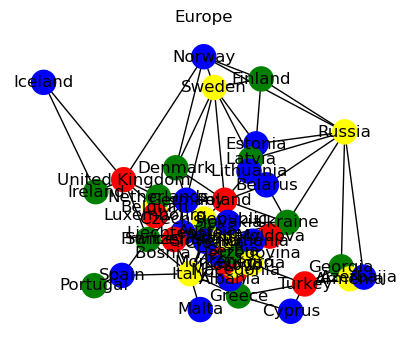

Generation Number: 2060 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

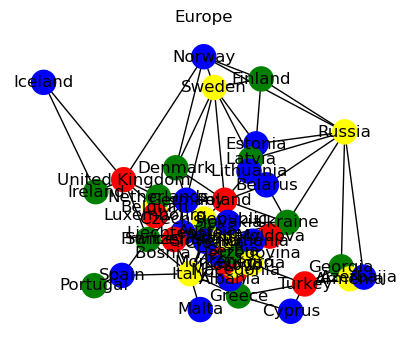

Generation Number: 2070 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

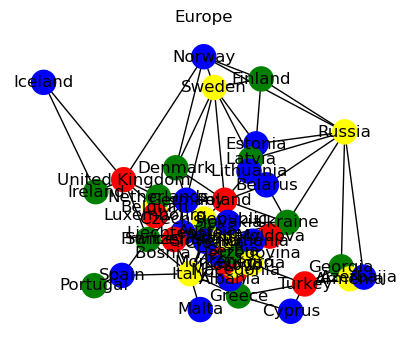

Generation Number: 2080 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

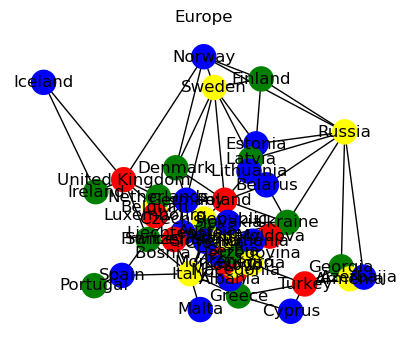

Generation Number: 2090 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

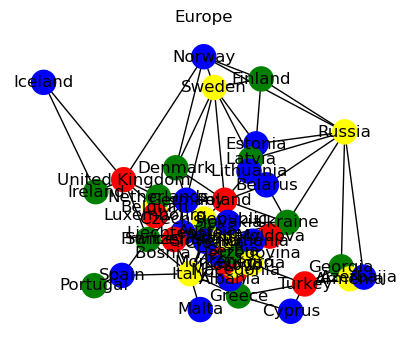

Generation Number: 2100 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

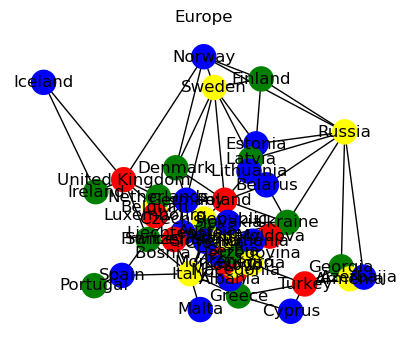

Generation Number: 2110 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

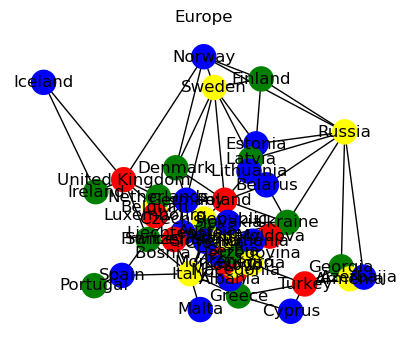

Generation Number: 2120 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

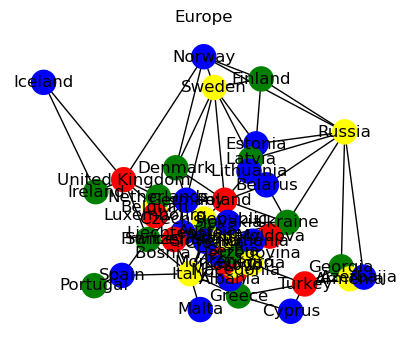

Generation Number: 2130 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

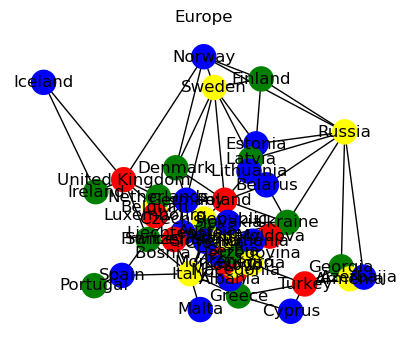

Generation Number: 2140 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

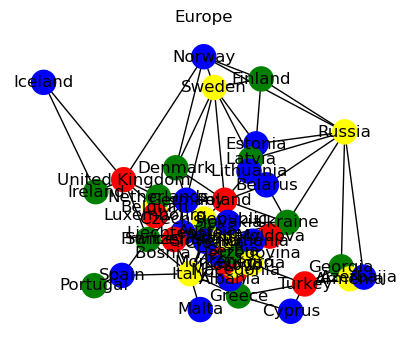

Generation Number: 2150 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

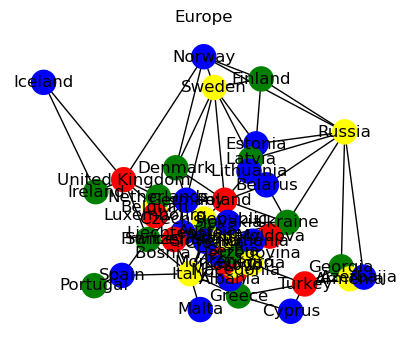

Generation Number: 2160 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

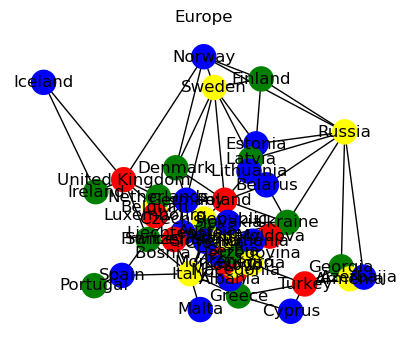

Generation Number: 2170 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

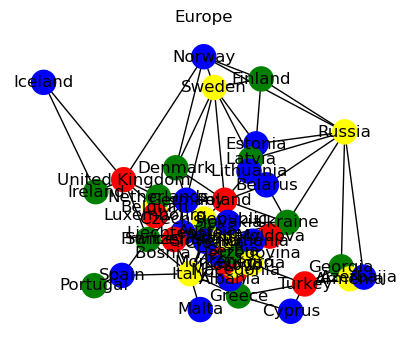

Generation Number: 2180 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

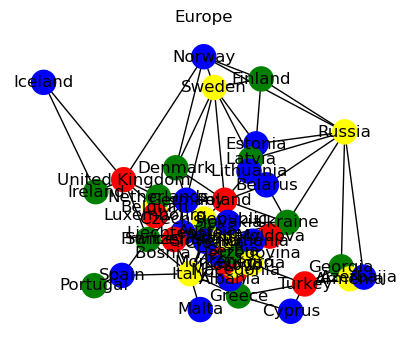

Generation Number: 2190 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

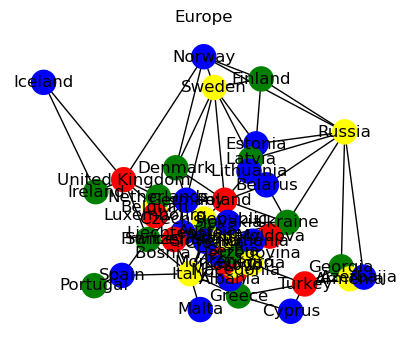

Generation Number: 2200 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

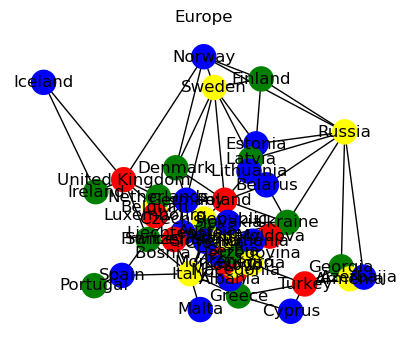

Generation Number: 2210 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

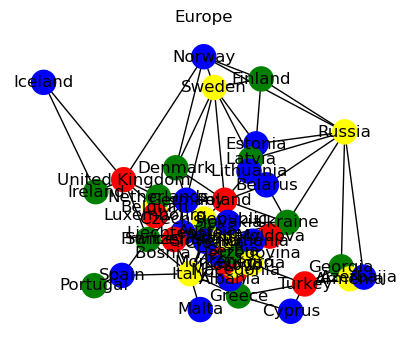

Generation Number: 2220 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

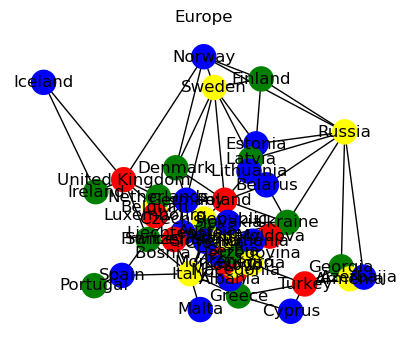

Generation Number: 2230 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

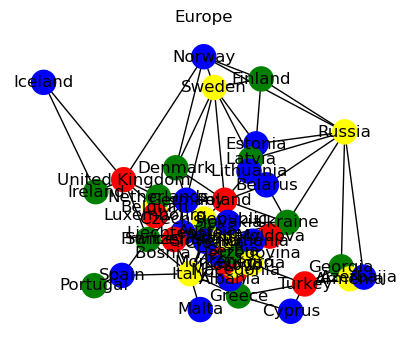

Generation Number: 2240 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

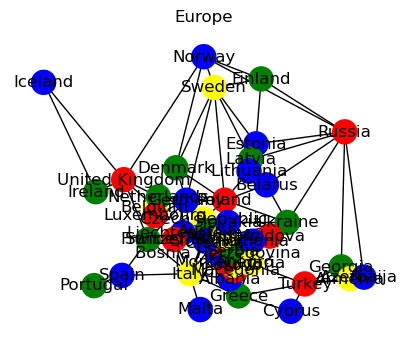

Generation Number: 2250 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

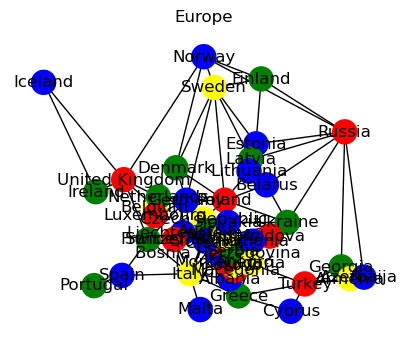

Generation Number: 2260 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

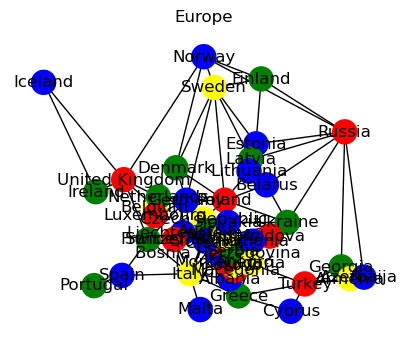

Generation Number: 2270 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

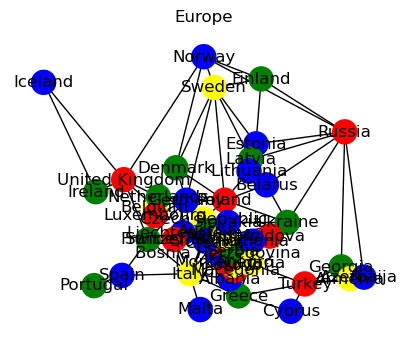

Generation Number: 2280 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

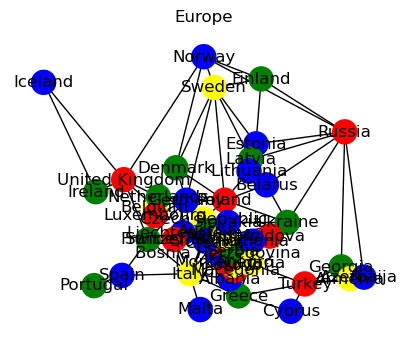

Generation Number: 2290 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

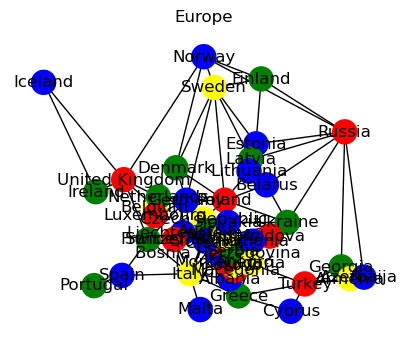

Generation Number: 2300 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

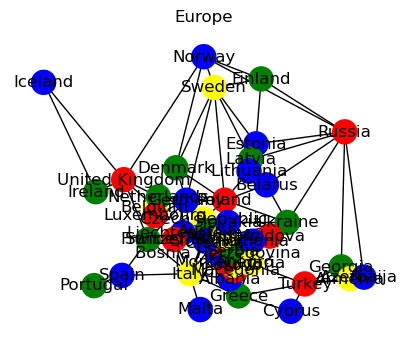

Generation Number: 2310 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

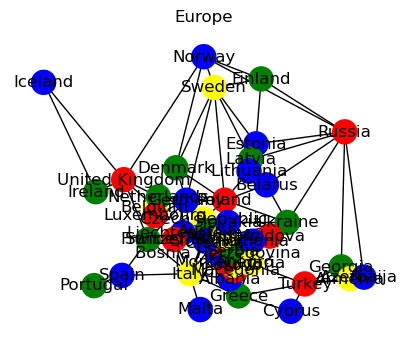

Generation Number: 2320 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

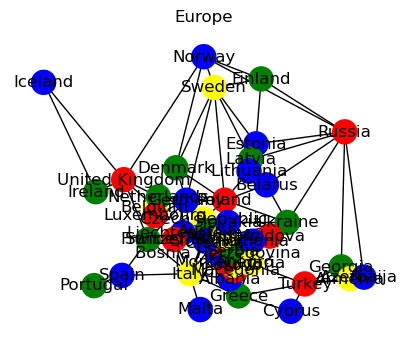

Generation Number: 2330 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

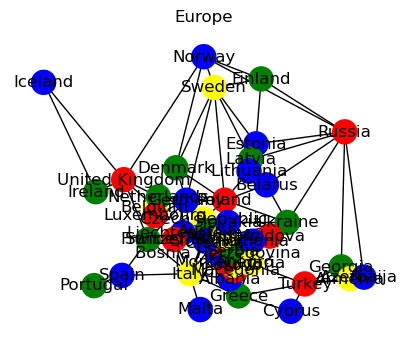

Generation Number: 2340 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

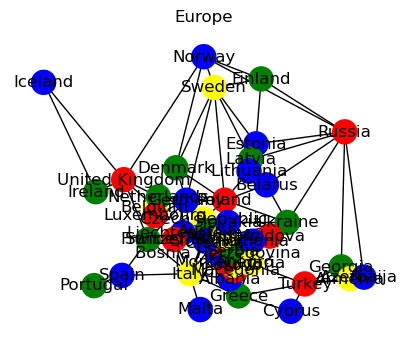

Generation Number: 2350 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

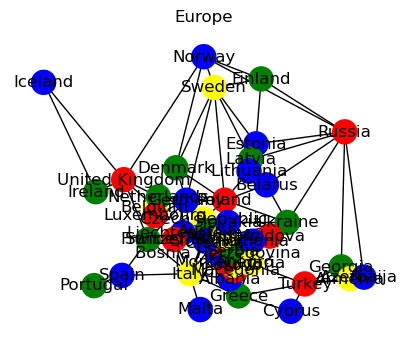

Generation Number: 2360 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

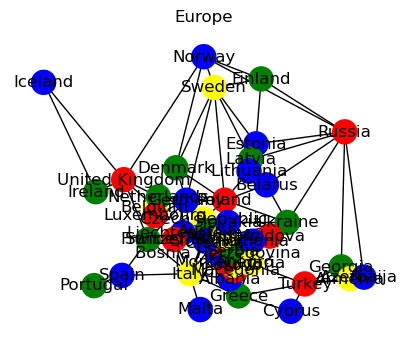

Generation Number: 2370 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

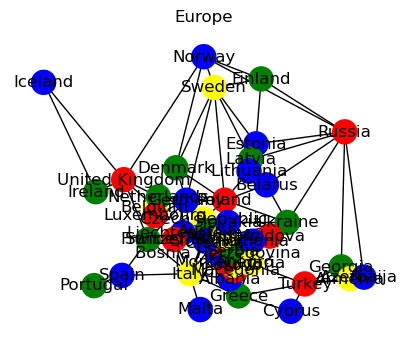

Generation Number: 2380 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

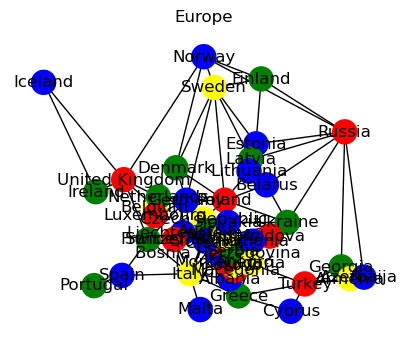

Generation Number: 2390 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

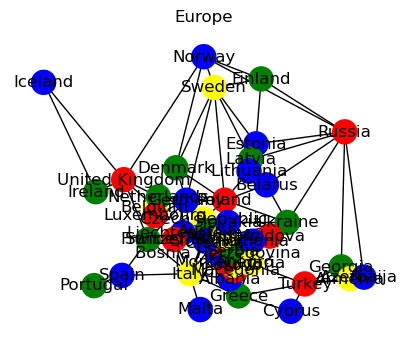

Generation Number: 2400 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

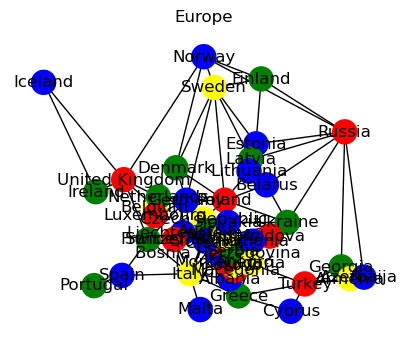

Generation Number: 2410 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

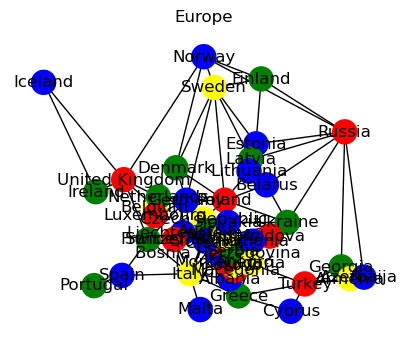

Generation Number: 2420 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

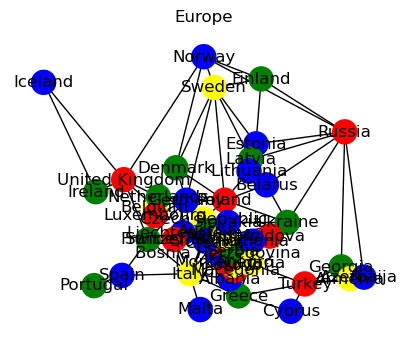

Generation Number: 2430 

Fitness: 110 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'blue'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'red'), ('Georgia', '

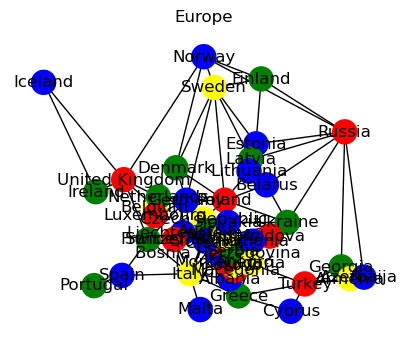

SOLUTION FOUND!

Generation Number: 2437 

Fitness: 111 

Genotype: [('Iceland', 'blue'), ('Ireland', 'green'), ('United Kingdom', 'red'), ('Portugal', 'green'), ('Spain', 'blue'), ('France', 'green'), ('Belgium', 'yellow'), ('Netherlands', 'green'), ('Luxembourg', 'red'), ('Germany', 'blue'), ('Denmark', 'green'), ('Norway', 'blue'), ('Sweden', 'yellow'), ('Finland', 'green'), ('Estonia', 'blue'), ('Latvia', 'green'), ('Lithuania', 'blue'), ('Poland', 'red'), ('Czech Republic', 'yellow'), ('Austria', 'green'), ('Liechtenstein', 'blue'), ('Switzerland', 'red'), ('Italy', 'yellow'), ('Malta', 'blue'), ('Greece', 'green'), ('Albania', 'blue'), ('Macedonia', 'red'), ('Kosovo', 'yellow'), ('Montenegro', 'red'), ('Bosnia Herzegovina', 'blue'), ('Serbia', 'green'), ('Croatia', 'red'), ('Slovenia', 'blue'), ('Hungary', 'yellow'), ('Slovakia', 'blue'), ('Belarus', 'yellow'), ('Ukraine', 'green'), ('Moldova', 'red'), ('Romania', 'blue'), ('Bulgaria', 'yellow'), ('Cyprus', 'blue'), ('Turkey', 'r

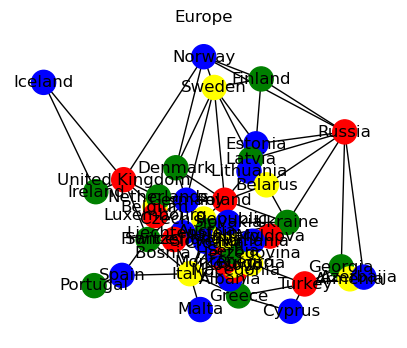

In [20]:
europe_solution = color_map(GA_Config(
    constraint_graph = europe_graph,
    graph_title = "Europe",
    graph_size = (5,4),
    solution_size = 111,
    color_list = ["red", "blue", "green", "yellow"],
    init_pop_size = 100, 
    parent_select_strat = "ROULETTE",
    roulette_alpha = 1,
    roulette_beta = 10,
    tour_num_select = 7,
    fitness_function = fitness_function,
    num_generations = 2500,
    crossover_rate = 1,
    crossover_location = "RANDOM",
    mutation_rate = 0.15,
    mutation_location = "RANDOM",
    mutation_value = "RANDOM",
    culling_rate = 0.5,
    seed = 0
))

## Test Europe Solution

In [21]:
if europe_solution:
    test_coloring(europe_graph, encode(europe_solution))

## Draw Europe Cartoon

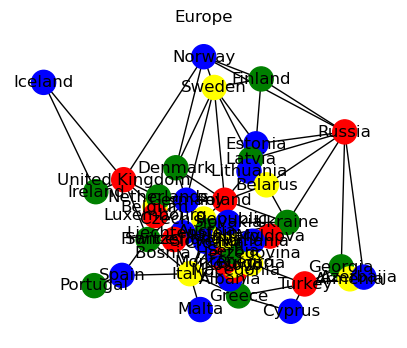

In [22]:
if europe_solution:
    fig, ax = plt.subplots(figsize=(5,4), dpi=100)
    draw_map(ax, "Europe", europe_graph, encode(europe_solution))
    plt.show()

## Genetic Algorithms

Color Europe from Assignment #4 using four colors: ["red", "blue", "green", "yellow"]. 

Your implementation should:

* Start with a random population of candidates
* Run for a defined number of generations
* Select parents (implement both roulette and tournament, but use one)
* Apply Crossover
* Apply Mutation
* Apply Culling (remove a fraction of the lowest fitness individuals from the new population)

You'll need encoders/decoders to switch between genomes and phenomes. 

You'll need an approproate fitness function. 

You'll need a suite of tunable parameters (number of generations, crossover rate, location, mutation rate, location, value, culling rate, and so on).

Every ten generations, print out the generation number, the fitness, genotype, and phenotype of the best individual in the population for the specific generation. Return the best individual of the entire run (in the same format).

Feel free to port over helper functions from your solution to Assignment #4. 

## OPTIONAL. BONUS.

Explore different settings for your parameter values and produce plots revealing the performance of your algorithm against the parameters.

<a id="run_genetic_algorithm_for_testing"></a>
## run_genetic_algorithm_for_testing(config, trace=False)

This function runs the genetic algorithm for testing purposes, iterating through selection, crossover, mutation, and culling steps to evolve the population until a solution is found or the maximum number of generations is reached.

* **config** Object: A configuration object that includes all necessary settings for the genetic algorithm, such as:
    - `seed`: Optional; used for reproducibility.
    - `constraint_graph`: The graph structure containing nodes and edges.
    - `init_pop_size`: Initial size of the population.
    - `color_list`: List of colors available for node assignments.
    - `num_generations`: Maximum number of generations to run the algorithm.
    - `parent_select_strat`: Strategy for parent selection (`"ROULETTE"` or `"TOURNAMENT"`).
    - `roulette_alpha`, `roulette_beta`: Parameters for the Beta distribution in roulette selection.
    - `tour_num_select`: Number of individuals to select for the tournament.
    - `crossover_rate`: Probability of crossover occurring between selected parents.
    - `crossover_location`: Location in the genome for crossover.
    - `mutation_rate`: Probability of mutation occurring for offspring.
    - `mutation_location`: Location in the genome for mutation.
    - `culling_rate`: Fraction of the population to be culled in each generation.
    - `solution_size`: The target fitness value that determines when a solution is found.

* **trace** bool: Optional; if set to `True`, prints detailed progress of the algorithm at every 10 generations or when a solution is found.

**returns**  
A tuple containing:
- `most_fit_individual`: The most fit individual found in the population.
- `generation_count`: The number of generations completed.
- `solution_found`: A boolean indicating whether a solution matching `config.solution_size` was found.
- `most_fit_fitness`: The fitness value of the most fit individual.

**Process Overview**
1. **Initialization**: Generates an initial random population using `random_population`.
2. **Main Loop**:
   - **Parent Selection**: Uses either roulette or tournament selection based on `config.parent_select_strat`.
   - **Crossover**: Performs crossover between parents if a random value is below `crossover_rate`.
   - **Mutation**: Applies mutation to offspring with a probability defined by `mutation_rate`.
   - **Culling**: Reduces the population size using the specified `culling_rate`.
   - **Evaluation**: Updates the `most_fit_individual` and its fitness.
3. **Trace Output**: If `trace=True`, prints summaries at intervals and draws the solution.
4. **Seed Adjustment**: Adjusts the seed after the first generation if a seed is specified.

**Notes**
- Interactive plotting (`plt.ioff()`) is turned off to prevent automatic plot rendering during the algorithm's execution, which can be useful for batch testing.
- The function iterates until `config.num_generations` is reached or a solution matching `config.solution_size` is found.
- A `trace` mode can be enabled for detailed output during execution for testing and analysis purposes.


In [23]:
def run_genetic_algorithm_for_testing(config, trace=False):
    if not config.seed == None: np.random.seed(config.seed)
    population, most_fit_individual, generation_count, solution_found = random_population(config.constraint_graph, config.init_pop_size, config.color_list), None, 0, False
    most_fit_fitness = 0
    plt.ioff()
    while generation_count < config.num_generations and not solution_found:
        parent_1, parent_2 = roulette_select(config.constraint_graph, population, config.fitness_function, config.roulette_alpha, config.roulette_beta) if config.parent_select_strat == "ROULETTE" else tournament_select(config.constraint_graph, population, config.fitness_function, config.tour_num_select)
        if not parent_1 == None and not parent_2 == None:
            child_1, child_2 = None, None
            if np.random.rand() < config.crossover_rate:
                child_1, child_2 = crossover(parent_1, parent_2, config.crossover_location)
            if not child_1 == None and not child_2 == None:
                for child in child_1, child_2:
                    if np.random.rand() < config.mutation_rate: mutation(child, config.color_list, config.mutation_location)
                population += [decode(child_1, config.constraint_graph), decode(child_2, config.constraint_graph)]
        population = culling(config.constraint_graph, population, config.fitness_function, config.culling_rate)
        most_fit_individual = get_best_individual(config.constraint_graph, population, config.fitness_function)
        most_fit_fitness = fitness_function(config.constraint_graph, encode(most_fit_individual))
        if most_fit_fitness == config.solution_size:
            solution_found = True
        if trace and (generation_count % 10 == 0 or solution_found):
            print_summary(config, generation_count, most_fit_fitness, encode(most_fit_individual), solution_found)
        if generation_count == 0 and not config.seed == None: np.random.seed(config.seed + 1)
        generation_count += 1
    return most_fit_individual, generation_count, solution_found, most_fit_fitness

## Exploring Mutation Rates

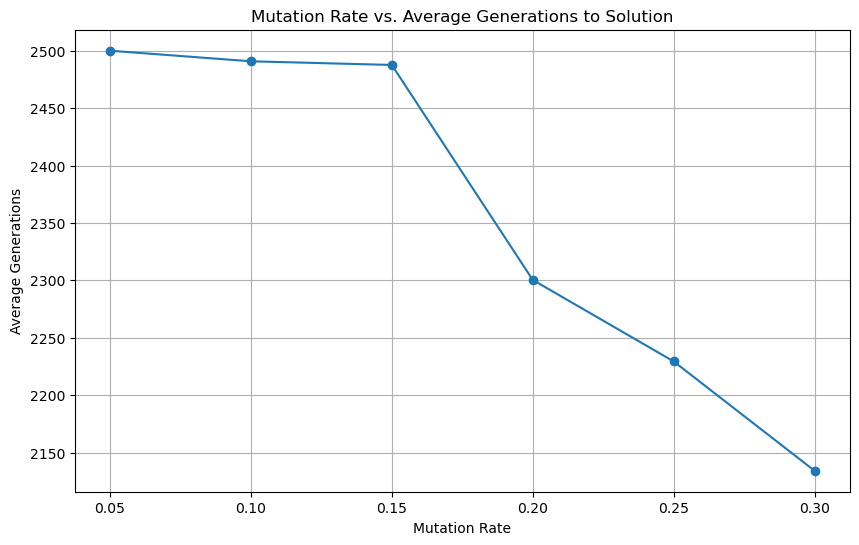

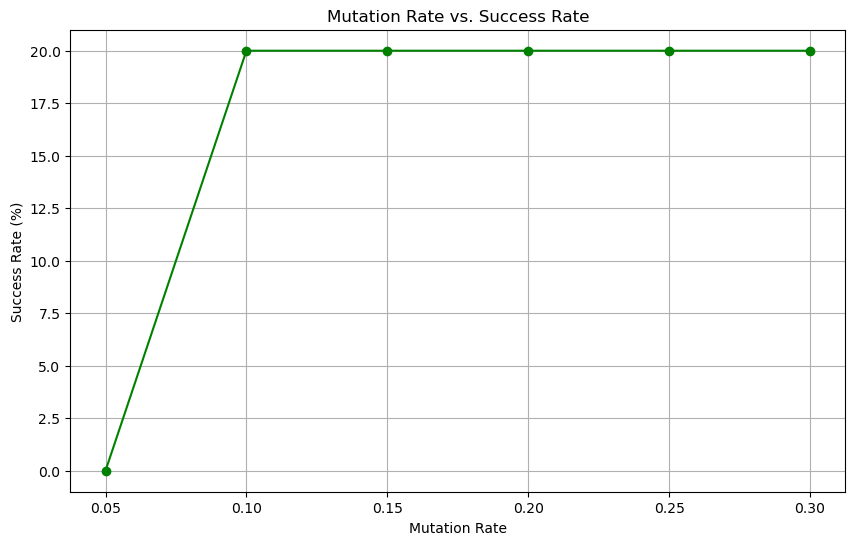

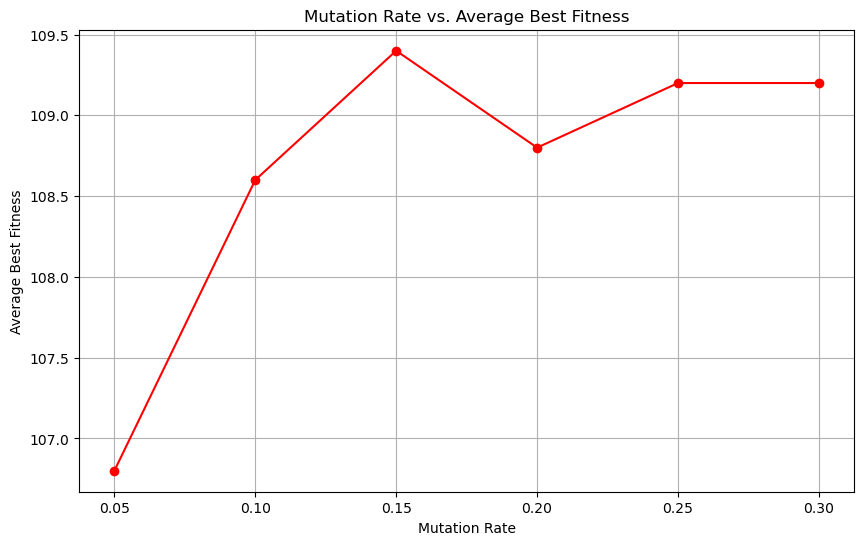

In [24]:
mutation_rates = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3]

def run_experiment(parameter_name, parameter_values, num_runs=5):
    results = []

    for value in parameter_values:
        generations_to_solution = []
        success_count = 0
        best_fitnesses = []

        for run in range(num_runs):

            seed_value = run
            config = GA_Config(
                constraint_graph = europe_graph,
                graph_title = "Europe",
                graph_size = (5,4),
                solution_size = 111,
                color_list = ["red", "blue", "green", "yellow"],
                init_pop_size = 100, 
                parent_select_strat = "ROULETTE",
                roulette_alpha = 1,
                roulette_beta = 10,
                tour_num_select = 7,
                fitness_function = fitness_function,
                num_generations = 2500,
                crossover_rate = 1,
                crossover_location = "RANDOM",
                mutation_rate = value if parameter_name == 'mutation_rate' else 0.15,
                mutation_location = "RANDOM",
                mutation_value = "RANDOM",
                culling_rate = 0.5,
                seed = seed_value
            )

            most_fit_individual, gen_count, solution_found, most_fit_fitness = run_genetic_algorithm_for_testing(config)
            
            if solution_found:
                generations_to_solution.append(gen_count)
                success_count += 1
            else:
                generations_to_solution.append(config.num_generations)
            best_fitnesses.append(most_fit_fitness)

        avg_generations = sum(generations_to_solution) / num_runs
        success_rate = (success_count / num_runs) * 100
        avg_best_fitness = sum(best_fitnesses) / num_runs

        results.append({
            'value': value,
            'avg_generations': avg_generations,
            'success_rate': success_rate,
            'avg_best_fitness': avg_best_fitness
        })

    return results

mutation_results = run_experiment('mutation_rate', mutation_rates)

mutation_values = [result['value'] for result in mutation_results]
avg_generations = [result['avg_generations'] for result in mutation_results]
success_rates = [result['success_rate'] for result in mutation_results]
avg_best_fitnesses = [result['avg_best_fitness'] for result in mutation_results]

plt.figure(figsize=(10, 6))
plt.plot(mutation_values, avg_generations, marker='o')
plt.title('Mutation Rate vs. Average Generations to Solution')
plt.xlabel('Mutation Rate')
plt.ylabel('Average Generations')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(mutation_values, success_rates, marker='o', color='green')
plt.title('Mutation Rate vs. Success Rate')
plt.xlabel('Mutation Rate')
plt.ylabel('Success Rate (%)')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(mutation_values, avg_best_fitnesses, marker='o', color='red')
plt.title('Mutation Rate vs. Average Best Fitness')
plt.xlabel('Mutation Rate')
plt.ylabel('Average Best Fitness')
plt.grid(True)
plt.show()

## Exploring Crossover Rates

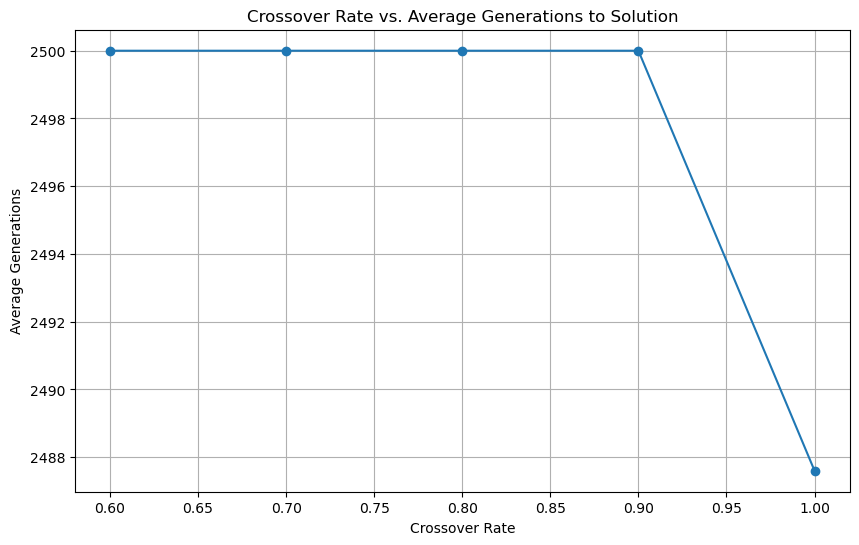

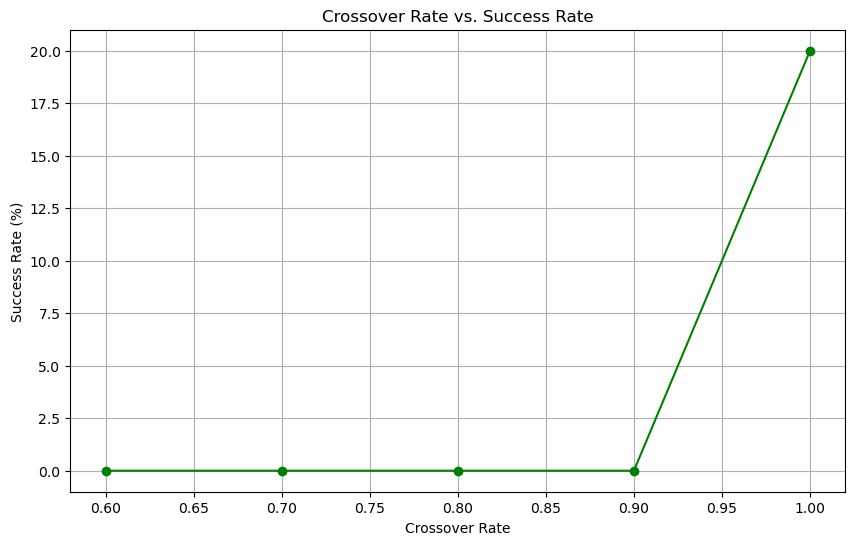

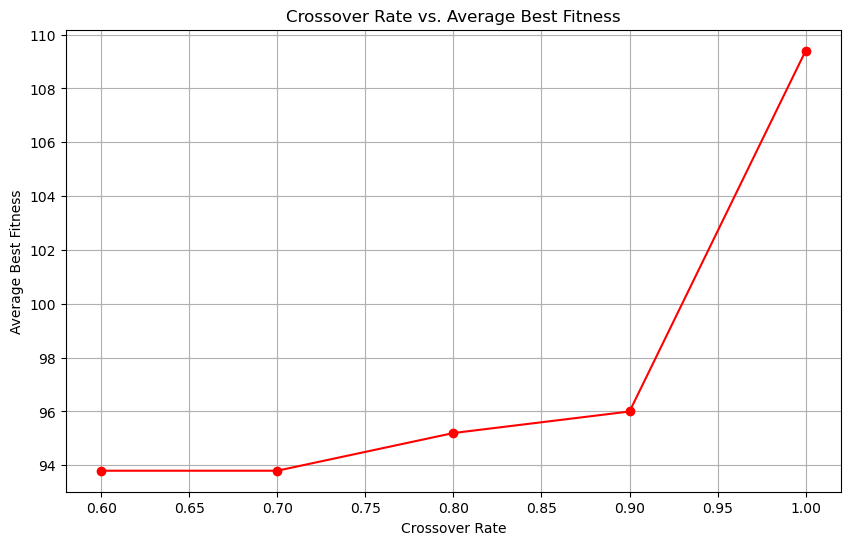

In [25]:
crossover_rates = [0.6, 0.7, 0.8, 0.9, 1.0]

def run_experiment_crossover(parameter_name, parameter_values, num_runs=5):
    results = []

    for value in parameter_values:
        generations_to_solution = []
        success_count = 0
        best_fitnesses = []

        for run in range(num_runs):
            seed_value = run
            config = GA_Config(
                constraint_graph = europe_graph,
                graph_title = "Europe",
                graph_size = (5,4),
                solution_size = 111,
                color_list = ["red", "blue", "green", "yellow"],
                init_pop_size = 100, 
                parent_select_strat = "ROULETTE",
                roulette_alpha = 1,
                roulette_beta = 10,
                tour_num_select = 7,
                fitness_function = fitness_function,
                num_generations = 2500,
                crossover_rate = value if parameter_name == 'crossover_rate' else 1,
                crossover_location = "RANDOM",
                mutation_rate = 0.15,
                mutation_location = "RANDOM",
                mutation_value = "RANDOM",
                culling_rate = 0.5,
                seed = seed_value
            )

            most_fit_individual, gen_count, solution_found, most_fit_fitness = run_genetic_algorithm_for_testing(config)
            
            if solution_found:
                generations_to_solution.append(gen_count)
                success_count += 1
            else:
                generations_to_solution.append(config.num_generations)
            best_fitnesses.append(most_fit_fitness)

        avg_generations = sum(generations_to_solution) / num_runs
        success_rate = (success_count / num_runs) * 100
        avg_best_fitness = sum(best_fitnesses) / num_runs

        results.append({
            'value': value,
            'avg_generations': avg_generations,
            'success_rate': success_rate,
            'avg_best_fitness': avg_best_fitness
        })

    return results

crossover_results = run_experiment_crossover('crossover_rate', crossover_rates)

crossover_values = [result['value'] for result in crossover_results]
avg_generations = [result['avg_generations'] for result in crossover_results]
success_rates = [result['success_rate'] for result in crossover_results]
avg_best_fitnesses = [result['avg_best_fitness'] for result in crossover_results]

plt.figure(figsize=(10, 6))
plt.plot(crossover_values, avg_generations, marker='o')
plt.title('Crossover Rate vs. Average Generations to Solution')
plt.xlabel('Crossover Rate')
plt.ylabel('Average Generations')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(crossover_values, success_rates, marker='o', color='green')
plt.title('Crossover Rate vs. Success Rate')
plt.xlabel('Crossover Rate')
plt.ylabel('Success Rate (%)')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(crossover_values, avg_best_fitnesses, marker='o', color='red')
plt.title('Crossover Rate vs. Average Best Fitness')
plt.xlabel('Crossover Rate')
plt.ylabel('Average Best Fitness')
plt.grid(True)
plt.show()

## Exploring Population Size

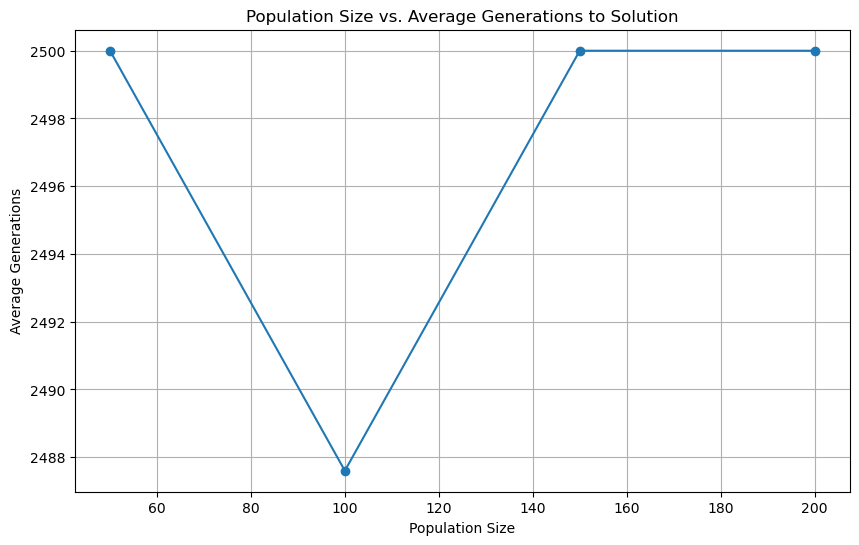

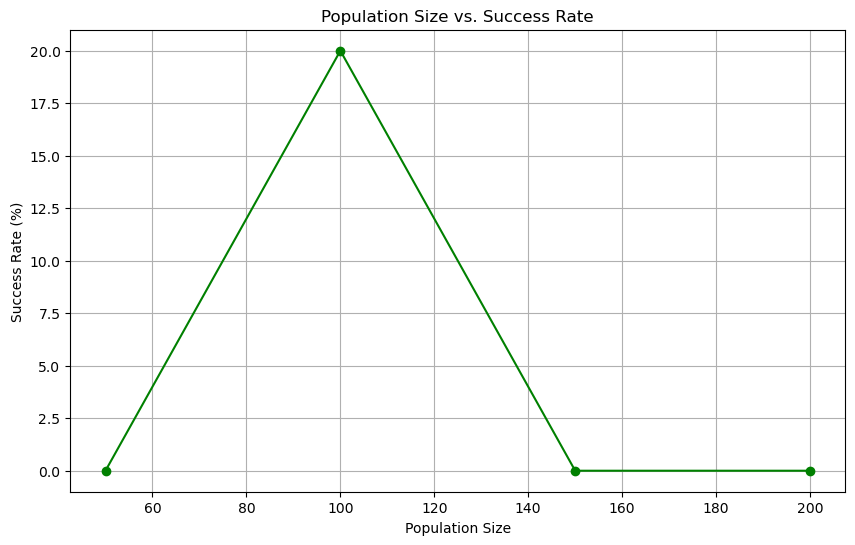

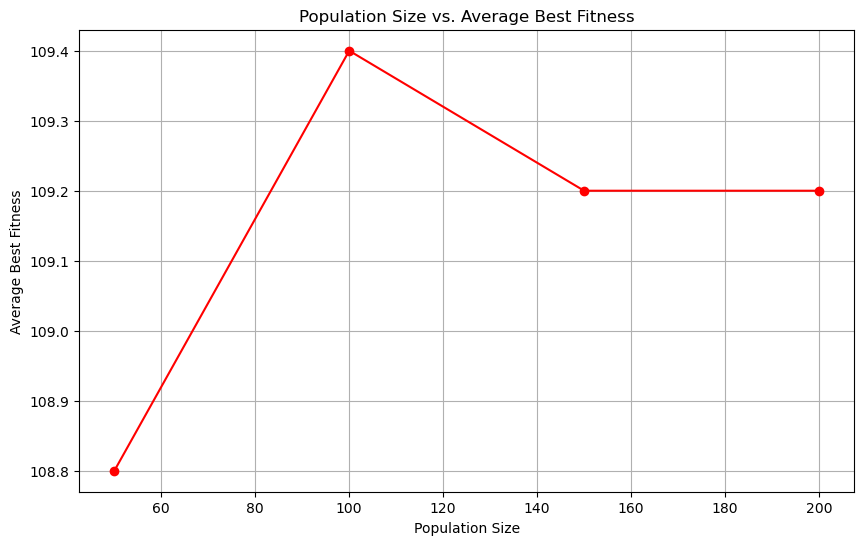

In [26]:
population_sizes = [50, 100, 150, 200]

def run_experiment_population(parameter_name, parameter_values, num_runs=5):
    results = []

    for value in parameter_values:
        generations_to_solution = []
        success_count = 0
        best_fitnesses = []

        for run in range(num_runs):
            seed_value = run
            config = GA_Config(
                constraint_graph = europe_graph,
                graph_title = "Europe",
                graph_size = (5,4),
                solution_size = 111,
                color_list = ["red", "blue", "green", "yellow"],
                init_pop_size = value if parameter_name == 'init_pop_size' else 100, 
                parent_select_strat = "ROULETTE",
                roulette_alpha = 1,
                roulette_beta = 10,
                tour_num_select = 7,
                fitness_function = fitness_function,
                num_generations = 2500,
                crossover_rate = 1,
                crossover_location = "RANDOM",
                mutation_rate = 0.15,
                mutation_location = "RANDOM",
                mutation_value = "RANDOM",
                culling_rate = 0.5,
                seed = seed_value
            )

            most_fit_individual, gen_count, solution_found, most_fit_fitness = run_genetic_algorithm_for_testing(config)
            
            if solution_found:
                generations_to_solution.append(gen_count)
                success_count += 1
            else:
                generations_to_solution.append(config.num_generations)
            best_fitnesses.append(most_fit_fitness)

        avg_generations = sum(generations_to_solution) / num_runs
        success_rate = (success_count / num_runs) * 100
        avg_best_fitness = sum(best_fitnesses) / num_runs

        results.append({
            'value': value,
            'avg_generations': avg_generations,
            'success_rate': success_rate,
            'avg_best_fitness': avg_best_fitness
        })

    return results

population_results = run_experiment_population('init_pop_size', population_sizes)

population_values = [result['value'] for result in population_results]
avg_generations = [result['avg_generations'] for result in population_results]
success_rates = [result['success_rate'] for result in population_results]
avg_best_fitnesses = [result['avg_best_fitness'] for result in population_results]

plt.figure(figsize=(10, 6))
plt.plot(population_values, avg_generations, marker='o')
plt.title('Population Size vs. Average Generations to Solution')
plt.xlabel('Population Size')
plt.ylabel('Average Generations')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(population_values, success_rates, marker='o', color='green')
plt.title('Population Size vs. Success Rate')
plt.xlabel('Population Size')
plt.ylabel('Success Rate (%)')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(population_values, avg_best_fitnesses, marker='o', color='red')
plt.title('Population Size vs. Average Best Fitness')
plt.xlabel('Population Size')
plt.ylabel('Average Best Fitness')
plt.grid(True)
plt.show()

## Exploring Culling Rates

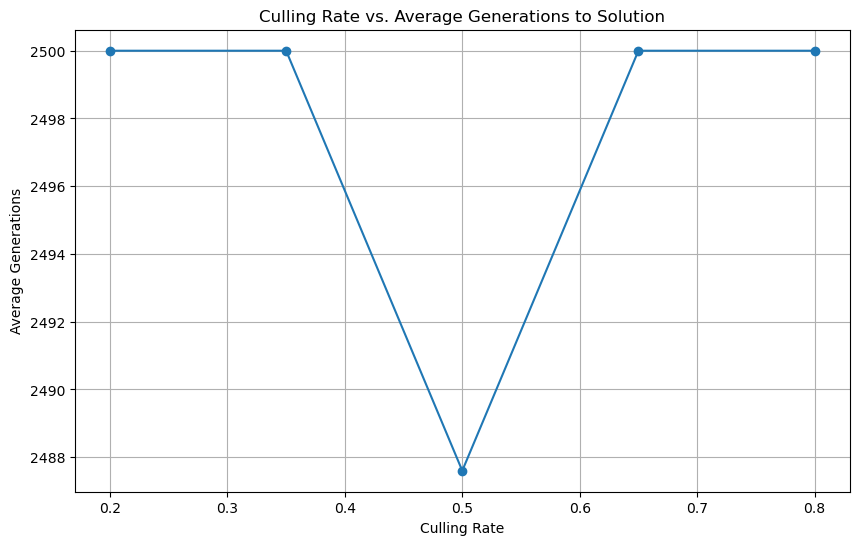

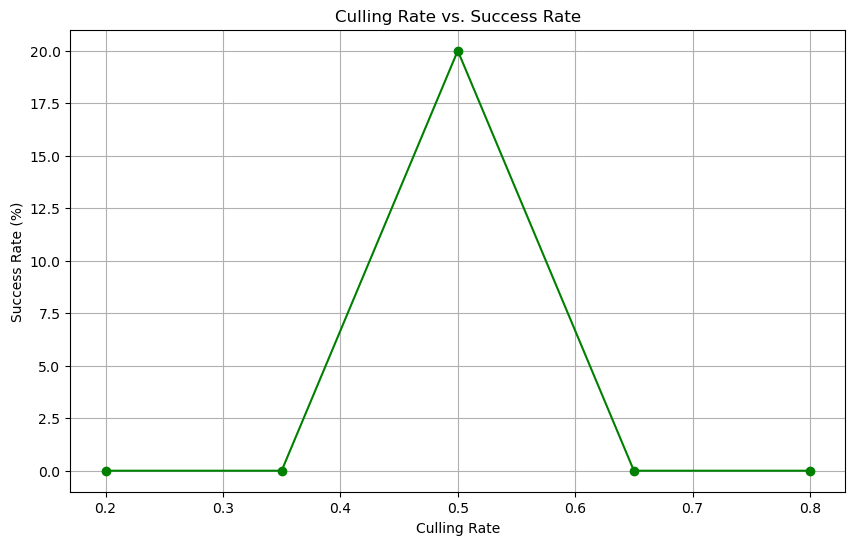

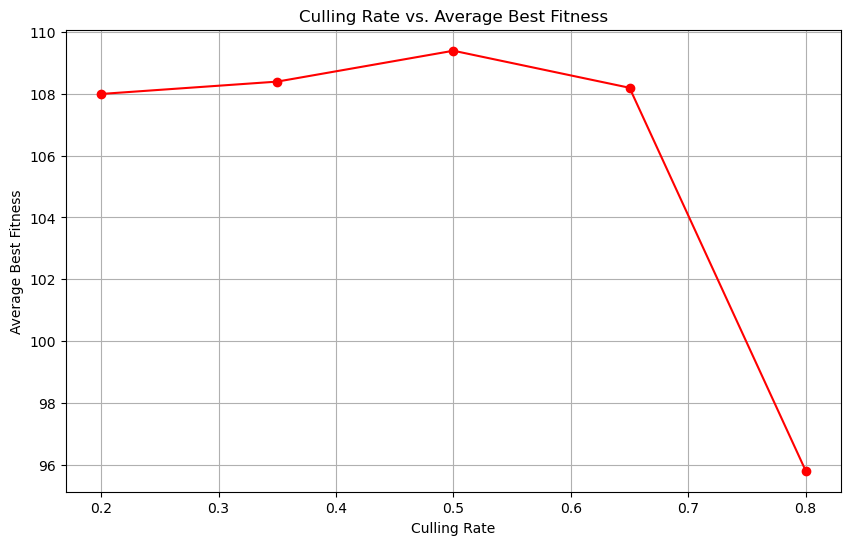

In [27]:
culling_rates = [0.2, 0.35, 0.5, 0.65, 0.8]

def run_experiment_culling(parameter_name, parameter_values, num_runs=5):
    results = []

    for value in parameter_values:
        generations_to_solution = []
        success_count = 0
        best_fitnesses = []

        for run in range(num_runs):
            seed_value = run
            config = GA_Config(
                constraint_graph = europe_graph,
                graph_title = "Europe",
                graph_size = (5,4),
                solution_size = 111,
                color_list = ["red", "blue", "green", "yellow"],
                init_pop_size = 100, 
                parent_select_strat = "ROULETTE",
                roulette_alpha = 1,
                roulette_beta = 10,
                tour_num_select = 7,
                fitness_function = fitness_function,
                num_generations = 2500,
                crossover_rate = 1,
                crossover_location = "RANDOM",
                mutation_rate = 0.15,
                mutation_location = "RANDOM",
                mutation_value = "RANDOM",
                culling_rate = value if parameter_name == 'culling_rate' else 0.5,
                seed = seed_value
            )

            most_fit_individual, gen_count, solution_found, most_fit_fitness = run_genetic_algorithm_for_testing(config)
            
            if solution_found:
                generations_to_solution.append(gen_count)
                success_count += 1
            else:
                generations_to_solution.append(config.num_generations)
            best_fitnesses.append(most_fit_fitness)

        avg_generations = sum(generations_to_solution) / num_runs
        success_rate = (success_count / num_runs) * 100
        avg_best_fitness = sum(best_fitnesses) / num_runs

        results.append({
            'value': value,
            'avg_generations': avg_generations,
            'success_rate': success_rate,
            'avg_best_fitness': avg_best_fitness
        })

    return results

culling_results = run_experiment_culling('culling_rate', culling_rates)

culling_values = [result['value'] for result in culling_results]
avg_generations = [result['avg_generations'] for result in culling_results]
success_rates = [result['success_rate'] for result in culling_results]
avg_best_fitnesses = [result['avg_best_fitness'] for result in culling_results]

plt.figure(figsize=(10, 6))
plt.plot(culling_values, avg_generations, marker='o')
plt.title('Culling Rate vs. Average Generations to Solution')
plt.xlabel('Culling Rate')
plt.ylabel('Average Generations')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(culling_values, success_rates, marker='o', color='green')
plt.title('Culling Rate vs. Success Rate')
plt.xlabel('Culling Rate')
plt.ylabel('Success Rate (%)')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(culling_values, avg_best_fitnesses, marker='o', color='red')
plt.title('Culling Rate vs. Average Best Fitness')
plt.xlabel('Culling Rate')
plt.ylabel('Average Best Fitness')
plt.grid(True)
plt.show()

## Before You Submit...

1. Re-read the general instructions provided above, and
2. Hit "Kernel"->"Restart & Run All".